<a href="https://colab.research.google.com/github/luyannn/prescriptive-analytics-project/blob/main/Group_Project_SEM01_Group5_Code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import random

# Set the seed to 100
np.random.seed(100)

NUM_OPPS = 50
NUM_VOLUNTEERS = 400
UTILITY_MULTIPLIER_ASSIGNMENT = 1
UTILITY_MULTIPLIER_INTEREST_MATCH = 5
UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH = 10
UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH = 100

In [ ]:
import os

# Set the working directory to the specified path
os.chdir('/Users/ngyuyang/Desktop/Code_21_Apr')

# Verify the current working directory
print("Current working directory:", os.getcwd())


Current working directory: /Users/ngyuyang/Desktop/Code_21_Apr


### Overview of Raw Dataset

In [ ]:
# Reading of volunteer opportunities csv file as a DataFrame
opps_df = pd.read_csv("volunteer_opportunity.csv")

# Overview of the data by viewing first few rows
print("First few rows of the DataFrame:")
print(opps_df.head())

# Summary statistics of the DataFrame
print("\nSummary statistics of the DataFrame:")
print(opps_df.describe())

# Display unique columns in the DataFrame
unique_columns = opps_df.columns.tolist()
print("Unique columns in the DataFrame:")
print(unique_columns)

# Number of rows in the DataFrame
num_rows = len(opps_df)
print(f"\nNumber of rows in the DataFrame: {num_rows}")

# Save the DataFrame as 'opps_df'
opps_df.to_csv('opps_df.csv', index=False)

First few rows of the DataFrame:
   opportunity_id  content_id  vol_requests  event_time  \
0            5211       38638             4           0   
1            5137       38099             1           0   
2            5008       37036             2           0   
3            5780       52861            20           0   
4            5275       39204             5           0   

                             title  hits  \
0                 General Services   411   
1  Health Insurance Claims Manager   119   
2                     Web designer    22   
3                       Math Tutor    29   
4       Arts Volunteer Opportunity   650   

                                             summary is_priority  category_id  \
0                    Moving, lifting and rearranging         NaN          NaN   
1  Position entails completing mental health clai...         NaN          2.0   
2             Build a website for an Afghan business         NaN          1.0   
3  Tutors wanted to hel

### Data Cleaning

In [ ]:
# Volunteer Opportunities Data
# Data cleaning of opportunities through dropping of unnecessary columns
opps_df.drop(
    columns=[
        "opportunity_id",
        "category_id",
        "display_url",
        "recurrence_type",
        "created_date",
        "last_modified_date",
        "start_date_date",
        "end_date_date",
        "vol_requests",
        "title",
        "summary",
        "content_id",
        "org_title",
        "event_time",
        "hits",
        "is_priority",
        "amsl",
        "amsl_unit",
        "org_content_id",
        "addresses_count",
        "locality",
        "region",
        "Postcode",
        "primary_loc",
        "hours",
        "status",
        "Borough",
        "Latitude",
        "Longitude",
        "Community Board",
        "Community Council ",
        "Census Tract",
        "BIN",
        "BBL",
        "NTA"
    ],
    inplace=True,
)

# Modifying social cause area to Singapore context based on NCSS's areas of social cause
replacement_mappings = {
    "Strengthening Communities": "Seniors in Need of Support",
    "Helping Neighbors in Need": "Families in Need of Assistance",
    "Education": "Children with Special Needs and Youth-At-Risk",
    "Environment": "Children with Special Needs and Youth-At-Risk",
    "Health": "Adults with Disabilities",
    "Emergency Preparedness": "Persons with Mental Health Conditions"
}

# Replace values in 'category_desc' column using the replacement mappings
opps_df['category_desc'] = opps_df['category_desc'].replace(replacement_mappings)

# Replace NA or empty strings with "Persons with Mental Health Conditions"
opps_df['category_desc'].fillna("Persons with Mental Health Conditions", inplace=True)
opps_df['category_desc'].replace("", "Persons with Mental Health Conditions", inplace=True)




#Generating list of top 10 skills in demand needed for volunteering with reference to NCSS's Guide on Service-Based Volunteering Partnerships and Case Studies
elements = ['Befriending', 'Counselling', 'Event Management', 'Facilitation', 'First-aid',
            'Photography', 'Story-telling', 'Tutoring', 'Ushering', 'Web Design']
percentages = [20, 5, 10, 13, 8, 6, 10, 15, 10, 3]

# Generate a new column with randomly sampled elements
opps_df['skills_required'] = np.random.choice(elements, size=len(opps_df), replace=True, p=percentages / np.sum(percentages))

# Create 'skills_compulsory' column based on 'skills_required'
opps_df['skills_compulsory'] = np.where(opps_df['skills_required'].isin(['Counselling', 'First-aid']), 1, 0)




# Generate 'manpower_needs' column with random values ranging from 1 to 10
manpower_needs = np.random.randint(1, 11, size=len(opps_df))

# Total manpower needs will be 1800
current_sum = np.sum(manpower_needs)
target_sum = 1800

# Ensure the total manpower needs equals 1800
if current_sum != target_sum:
    # Calculate the difference
    diff_sum = target_sum - current_sum

    # Randomly increase or decrease one of the values to match the target sum
    rand_index = np.random.choice(opps_df.index, size=abs(diff_sum), replace=True)
    manpower_needs[rand_index] += np.sign(diff_sum)

# Assign 'manpower_needs' to the DataFrame
opps_df['manpower_needs'] = manpower_needs




# Generate date of volunteering time with days Monday to Sunday
volunteering_times = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
percentages = [0.14, 0.15, 0.10, 0.14, 0.13, 0.17, 0.17]

# Generate 'volunteering_time' column with random values
volunteering_time = np.random.choice(volunteering_times, size=len(opps_df), replace=True, p=percentages)

# Assign 'volunteering_time' to the DataFrame
opps_df['volunteering_time'] = volunteering_time




# # Replace manpower_needs 0 with 1
opps_df["manpower_needs"] = opps_df["manpower_needs"].replace(0, 1)


# Creating reference lists for skills
skills_list_ordered = opps_df["skills_required"].unique().tolist()
skills_list_required = ["First-aid", "Counselling"]
skills_list_good_to_have = list(set(skills_list_ordered) - set(skills_list_required))
# Assign a random skill to skills_good_to_have
opps_df["skills_good_to_have"] = np.random.choice(skills_list_ordered, len(opps_df))
# Remove rows where skills_required and skills_good_to_have are the same
opps_df = opps_df[opps_df["skills_required"] != opps_df["skills_good_to_have"]]

# Creating reference list for social causes
social_causes_list_ordered = opps_df["category_desc"].unique().tolist()

# Creating reference list for days
days = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]

opps_df = opps_df.head(NUM_OPPS)
opps_df.head()

# Save the DataFrame to a CSV file
opps_df.to_csv('opportunities_cleaned.csv', index=False)
print("DataFrame saved to 'opportunities_cleaned.csv'")

DataFrame saved to 'opportunities_cleaned.csv'


In [ ]:
volunteer_df = pd.read_csv("volunteer.csv").dropna(inplace=False)

### DATA CLEANING ###
volunteer_df = volunteer_df.replace({"Yes": 1, "No": 0})

volunteer_df = volunteer_df.head(NUM_VOLUNTEERS)
volunteer_df

,Befriending,Counselling,Event Management,Facilitation,First-aid,Photography,Tutoring,Story-telling,Ushering,Web Design,...,Seniors in Need of Support,Adults with Disabilities,Families in Need of Assistance,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
0,0,1,1,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1,1,0,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,1,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,1,0,1,0,0,0,0,0,1,...,0,1,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
396,0,0,1,1,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
397,1,1,1,1,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
398,0,1,0,1,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0


### Data Transformation for Volunteer Opportunities Data

In [ ]:
### COMPULSORY SKILLS ###
# Split skills_required into individual columns
opps_skills_compulsory = opps_df["skills_required"].str.get_dummies(sep=",")
# Add missing columns
missing_cols = set(skills_list_ordered) - set(opps_skills_compulsory.columns)
for col in missing_cols:
    opps_skills_compulsory[col] = 0
opps_skills_compulsory = opps_skills_compulsory[skills_list_required]
opps_skills_compulsory = opps_skills_compulsory.to_numpy().astype(int)


### GOOD TO HAVE SKILLS ###
# Split skills_required into individual columns
opps_skills_good_to_have = opps_df["skills_required"].str.get_dummies(sep=",")
# Add missing columns
missing_cols = set(skills_list_ordered) - set(opps_skills_good_to_have.columns)
for col in missing_cols:
    opps_skills_good_to_have[col] = 0
opps_skills_good_to_have = opps_skills_good_to_have[skills_list_good_to_have]
opps_skills_good_to_have = opps_skills_good_to_have.to_numpy().astype(int)


### MANPOWER NEEDS ###
opps_manpower_needs = opps_df["manpower_needs"]
opps_manpower_needs = opps_manpower_needs.to_numpy().astype(int)


### SOCIAL CAUSES ###
# Split social_causes into individual columns
opps_social_causes = opps_df["category_desc"].str.get_dummies(sep=",")
# Add missing columns
missing_cols = set(social_causes_list_ordered) - set(opps_social_causes.columns)
for col in missing_cols:
    opps_social_causes[col] = 0
opps_social_causes = opps_social_causes[social_causes_list_ordered]
opps_social_causes = opps_social_causes.to_numpy().astype(int)


### OPPORTUNITY TIMESLOTS ###
# Split timeslots into individual columns
opps_timeslots = opps_df["volunteering_time"].str.get_dummies(sep=",")
# Add missing columns
missing_cols = set(days) - set(opps_timeslots.columns)
for col in missing_cols:
    opps_timeslots[col] = 0
opps_timeslots = opps_timeslots[days]
opps_timeslots = opps_timeslots.to_numpy().astype(int)

### NUMBER OF OPPORTUNITIES ###
n_opps = len(opps_df)

### Data Transformation for Volunteer Data

In [ ]:
### VOLUNTEER SKILLS ###
volunteer_skills_required = volunteer_df[skills_list_required].to_numpy().astype(int)
volunteer_skills_good_to_have = (
    volunteer_df[skills_list_good_to_have].to_numpy().astype(int)
)

### VOLUNTEER AVAILABILITY ###
volunteer_availability = volunteer_df[days]
volunteer_availability = volunteer_availability.mask(
    np.random.rand(*volunteer_availability.shape) < 0.30, 1
)
volunteer_availability = volunteer_availability.to_numpy().astype(int)

### VOLUNTEER INTEREST ###
volunteer_interest = volunteer_df[social_causes_list_ordered]
volunteer_interest = volunteer_interest.to_numpy().astype(int)

In [ ]:
def show_allocation(optimal_solution: dict):
    print("Columns = Volunteer ID")
    print("Rows = Opportunity ID")
    display(pd.DataFrame(optimal_solution).astype(int))

### GAI Prompt for Formulation

Assume the role of a data engineer specialized in data and prescriptive analytics. You are proficient in constructing mathematical models and adept at programming and solving these models using the Gurobi library. In our subsequent interactions, you will be tasked with coding various optimization models utilizing the Gurobi library. Your objectives are to ensure accurate results and adhere to the following guidelines:
1. Generate random parameters when specific parameters are not provided.
2. After solving each optimization problem, verify the problem status. If the status is "OPTIMAL", include code snippets to retrieve and display the optimal solutions and the objective value.
3. Disable output logging by setting the "OutputFlag" to 0.
4. Present the results in a concise and clear format, utilizing tables or graphical representations when beneficial.
5. Strive for code efficiency, utilizing the minimal amount of code necessary for model programming.
6. If possible, use “addVars” for non-scalar decision variables and use “addConstrs” for a batch of constraints. Also, please use “quicksum” instead of “sum”.
7. Be careful of the indices given that Python starts from 0 but most of the models start from 1.

This is the the formulation for the linear optimisation model
Let Nj be the number of volunteers needed for job j, where j = 1, … , n
Let Xij represent if volunteer i has been assigned to job j  
, where i = 1, … , m & j = 1, … , n
Let Sik represent the skills k that volunteer i has
, where i = 1, … , m & k = 1, … , 10
Let Hj represent if the job requires any specific skills, where j = 1, … , n
Let Rjk represent the skills k that is required for job j, where j = 1, … , n & k = 1, … , 10
Let Gjk represent the skills k that is good to have for job j, where j = 1, … , n & k = 1, … , 10
Let Cjz represent the cause z that is corresponding to job j, where j = 1, … , n & z = 1, … , 5
Let Piz represent the social cause z that volunteer i is interested in
, where i = 1, … , m & z = 1, … , 5
Let Aje represent the date that the volunteering role falls on for job j
, where j = 1, … , m and e=1, …, 14
Let Bie represent the date that the volunteer i is available for the volunteer dates
where i = 1, … , m and e=1, …, 14

### Objective Function
Maximize:
\[
\sum_{j=1}^{n} (H_j \times 100 \times \sum_{i=1}^{m} X_{ij})
+ \sum_{i=1}^{m} \sum_{j=1}^{n} X_{ij}
+ \sum_{i=1}^{m} \sum_{j=1}^{n} (5 \times X_{ij} \times \sum_{z=1}^{5} (P_{iz} \times C_{jz}))
+ \sum_{i=1}^{m} \sum_{j=1}^{n} (10 \times X_{ij} \times \sum_{k=1}^{10} (S_{ik} \times G_{jk}))
\]

### Constraints
- **Demand Constraint**: Each volunteer opportunity must have the required number of volunteers:
\[
\sum_{i=1}^{m} X_{ij} \geq N_j \quad \forall j
\]

- **Skillset Constraint**: All volunteers must have the required skills for the jobs with mandatory skillsets:
\[
S_{ik} \geq R_{jk} \quad \forall i, j, k
\]

- **Availability Constraint**: Volunteers must be available at the timing of the volunteer opportunity:
\[
0 \leq X_{ij} \leq B_{ie} \quad \forall i, j, e
\]

- **Volunteer Constraint**: Each volunteer can be assigned to only one volunteer opportunity:
\[
\sum_{j=1}^{n} X_{ij} \leq 1 \quad \forall i
\]

In [ ]:
import gurobipy as gp
from gurobipy import GRB


def optimize_volunteering(
    volunteer_skills_good_to_have,
    num_jobs,
    job_good_to_have,
    job_causes,
    volunteer_interests,
    number_of_volunteers_needed,
    verbose=False,
):
    # Create a new model
    model = gp.Model("Volunteering_Optimization")

    # Disable output logging
    model.Params.OutputFlag = 0

    # Sets
    num_volunteers = range(len(volunteer_skills_good_to_have))
    num_jobs = range(num_jobs)
    num_skills = range(len(volunteer_skills_good_to_have[0]))
    num_causes = range(len(job_causes[0]))

    # Decision Variables
    X = model.addVars(num_volunteers, num_jobs, vtype=GRB.BINARY, name="X")

    # Objective Function
    obj_expr = (
        # When volunteer's interest aligns with the job's social cause
        gp.quicksum(
            X[i, j]
            * job_causes[j][z]
            * volunteer_interests[i][z]
            * UTILITY_MULTIPLIER_INTEREST_MATCH
            for i in num_volunteers
            for j in num_jobs
            for z in num_causes
        )
        # When volunteer's skills align with the job's good to have skills
        + gp.quicksum(
            X[i, j]
            * volunteer_skills_good_to_have[i][k]
            * job_good_to_have[j][k]
            * UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH
            for i in num_volunteers
            for j in num_jobs
            for k in num_skills
        )
        + gp.quicksum(
            X[i, j] * UTILITY_MULTIPLIER_ASSIGNMENT
            for i in num_volunteers
            for j in num_jobs
        )
    )

    model.setObjective(obj_expr, sense=GRB.MAXIMIZE)

    # Constraints
    for j in num_jobs:
        model.addConstr(
            X.sum("*", j) <= number_of_volunteers_needed[j], name=f"job_{j}_constraint"
        )

    # Each volunteer can only be assigned to one job
    for i in num_volunteers:
        model.addConstr(X.sum(i, "*") <= 1, name=f"volunteer_{i}_constraint")

    # Solve the model
    model.optimize()

    # Verify status
    if model.status == GRB.OPTIMAL:
        print("Optimal solution found!") if verbose else None
        # Retrieve and display optimal solutions
        optimal_solution = {
            (i + 1): {j + 1: X[i, j].x for j in num_jobs} for i in num_volunteers
        }
        # Display objective value
        print(f"Objective value: {model.objVal}") if verbose else None
        return optimal_solution, model.objVal
    else:
        print("No optimal solution found.") if verbose else None
        return None, None

In [ ]:
# To compare objective score of two sequences, depending on whether we optimize for opportunities that require the
# first skill first or the second skill first
def compare_sequence_optimization(
    first_skill,
    volunteer_skills_required,
    opps_skills_compulsory,
    jobs_on_day,
    available_volunteers,
    allocated_volunteers,
    volunteer_skills_good_to_have,
    opps_skills_good_to_have,
    opps_social_causes,
    volunteer_interest,
    opps_manpower_needs,
    verbose=False,
):
    (
        print("Volunter skills good to have", volunteer_skills_good_to_have)
        if verbose
        else None
    )

    local_allocated_volunteers = allocated_volunteers.copy()

    print("Volunteers remaining:", available_volunteers) if verbose else None

    # Init second skill as the opposite of the first skill

    second_skill = 1 - first_skill

    # Initialize variables for partial optimization

    partial_optimal_solution_first_skill = {}

    partial_optimal_solution_second_skill = {}

    partial_optimal_solution_remainder = {}

    partial_objective_value_first_skill = 0

    partial_objective_value_second_skill = 0

    partial_objective_value_remainder = 0

    original_idx_solution_first_skill = {}

    original_idx_solution_second_skill = {}

    original_idx_solution_remainder = {}

    available_volunteers_with_first_skill = []

    available_volunteers_with_second_skill = []

    # Filter opportunities and volunteers based on the first compulsory skill

    jobs_with_first_skill = [
        j
        for j in jobs_on_day
        if opps_skills_compulsory[jobs_on_day.index(j)][first_skill] == 1
    ]

    print("Jobs with first skill:", jobs_with_first_skill) if verbose else None

    if jobs_with_first_skill:

        available_volunteers_with_first_skill = [
            v
            for v in available_volunteers
            if volunteer_skills_required[available_volunteers.index(v)][first_skill]
            == 1
        ]

        (
            print(
                "Available volunteers with first skill:",
                available_volunteers_with_first_skill,
            )
            if verbose
            else None
        )
        # Firstly optimize for opportunities that require the first skill

        if available_volunteers_with_first_skill:

            (
                partial_optimal_solution_first_skill,
                partial_objective_value_first_skill,
            ) = optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[available_volunteers.index(v)]
                    for v in available_volunteers_with_first_skill
                ],
                num_jobs=len(jobs_with_first_skill),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                job_causes=[
                    opps_social_causes[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers.index(v)]
                    for v in available_volunteers_with_first_skill
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                verbose=verbose,
            )
            # Mapping back to original indices

            original_idx_solution_first_skill = {
                available_volunteers_with_first_skill[i]: {
                    jobs_with_first_skill[j]: partial_optimal_solution_first_skill[
                        i + 1
                    ][j + 1]
                    for j in range(len(jobs_with_first_skill))
                }
                for i in range(len(available_volunteers_with_first_skill))
            }

            # Update allocated volunteers

            local_allocated_volunteers += [
                v
                for v in available_volunteers_with_first_skill
                if v in partial_optimal_solution_first_skill.keys()
                and 1 in partial_optimal_solution_first_skill[v].values()
            ]

    (
        print("Allocated after first round:", local_allocated_volunteers)
        if verbose
        else None
    )

    # Filter opportunities and volunteers based on the second compulsory skill

    jobs_with_second_skill = [
        j
        for j in jobs_on_day
        if opps_skills_compulsory[jobs_on_day.index(j)][second_skill] == 1
    ]

    print("Jobs with second skill:", jobs_with_second_skill) if verbose else None

    if jobs_with_second_skill:

        available_volunteers_with_second_skill = [
            v
            for v in available_volunteers
            if volunteer_skills_required[available_volunteers.index(v)][second_skill]
            == 1
            and v not in local_allocated_volunteers
        ]

        (
            print(
                "Available volunteers with second skill:",
                available_volunteers_with_second_skill,
            )
            if verbose
            else None
        )
        # Secondly optimize for opportunities that require the second skill

        if available_volunteers_with_second_skill:

            (
                partial_optimal_solution_second_skill,
                partial_objective_value_second_skill,
            ) = optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[available_volunteers.index(v)]
                    for v in available_volunteers_with_second_skill
                ],
                num_jobs=len(jobs_with_second_skill),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                job_causes=[
                    opps_social_causes[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers.index(v)]
                    for v in available_volunteers_with_second_skill
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                verbose=verbose,
            )

            (
                print(
                    "Partial Optimal Solution Second Skill:",
                    partial_optimal_solution_second_skill,
                )
                if verbose
                else None
            )
            # Mapping back to original indices

            original_idx_solution_second_skill = {
                available_volunteers_with_second_skill[i]: {
                    jobs_with_second_skill[j]: partial_optimal_solution_second_skill[
                        i + 1
                    ][j + 1]
                    for j in range(len(jobs_with_second_skill))
                }
                for i in range(len(available_volunteers_with_second_skill))
            }
            # Update allocated volunteers

            local_allocated_volunteers += [
                v
                for v in available_volunteers_with_second_skill
                if v in partial_optimal_solution_second_skill.keys()
                and 1 in partial_optimal_solution_second_skill[v].values()
            ]

    (
        print("Allocated after second round:", local_allocated_volunteers)
        if verbose
        else None
    )

    # Filter remaining opportunities and volunteers

    jobs_remainder = [
        j
        for j in jobs_on_day
        if j not in jobs_with_first_skill + jobs_with_second_skill
    ]

    available_volunteers_remainder = [
        v for v in available_volunteers if v not in local_allocated_volunteers
    ]

    (
        print("Available volunteers for remainder:", available_volunteers_remainder)
        if verbose
        else None
    )
    # Thirdly optimize for remaining opportunities

    if jobs_remainder and available_volunteers_remainder:

        partial_optimal_solution_remainder, partial_objective_value_remainder = (
            optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[
                        available_volunteers_remainder.index(v)
                    ]
                    for v in available_volunteers_remainder
                ],
                num_jobs=len(jobs_remainder),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_remainder.index(j)]
                    for j in jobs_remainder
                ],
                job_causes=[
                    opps_social_causes[jobs_remainder.index(j)] for j in jobs_remainder
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers_remainder.index(v)]
                    for v in available_volunteers_remainder
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_remainder.index(j)] for j in jobs_remainder
                ],
                verbose=verbose,
            )
        )
        # Mapping back to original indices

        original_idx_solution_remainder = {
            available_volunteers_remainder[i]: {
                jobs_remainder[j]: partial_optimal_solution_remainder[i + 1][j + 1]
                for j in range(len(jobs_remainder))
            }
            for i in range(len(available_volunteers_remainder))
        }

    # Calculate objective value of the sequence

    sequence_objective_value = (
        # Utility score = multiplier * number of volunteers allocated for opportunities that require the any skill
        UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH
        * (
            pd.DataFrame(partial_optimal_solution_first_skill)
            .to_numpy()
            .astype(int)
            .sum()
            + pd.DataFrame(partial_optimal_solution_second_skill)
            .to_numpy()
            .astype(int)
            .sum()
        )
        + partial_objective_value_first_skill
        + partial_objective_value_second_skill
        + partial_objective_value_remainder
    )
    (
        print(f"Sequence {first_skill} Objective Value: {sequence_objective_value}")
        if verbose
        else None
    )
    # Combine all allocations

    sequence_allocation = {
        **original_idx_solution_first_skill,
        **original_idx_solution_second_skill,
        **original_idx_solution_remainder,
    }

    return sequence_allocation, sequence_objective_value

In [ ]:
def availability_decomposed_optimization(
    volunteer_skills_required,
    volunteer_skills_good_to_have,
    num_jobs,
    opps_skills_compulsory,
    opps_skills_good_to_have,
    opps_social_causes,
    volunteer_interest,
    opps_timeslots,
    volunteer_availability,
    opps_manpower_needs,
    verbose=False,
):
    running_decomposed_objective_value = 0
    running_decomposed_allocation = np.zeros(
        (len(volunteer_skills_good_to_have), num_jobs)
    )

    for day_idx in range(7):  # Days of the week
        # Filter jobs available on this day
        # jobs_on_day is a list of indices of jobs available on this day
        print() if verbose else None
        print("Day:", days[day_idx]) if verbose else None
        jobs_on_day = [
            j for j, slots in enumerate(opps_timeslots) if slots[day_idx] == 1
        ]
        if not jobs_on_day:
            continue  # No jobs available on this day
        print(f"Jobs available on {days[day_idx]}:", jobs_on_day) if verbose else None

        allocated_volunteers = []

        # Filter volunteers available on this day
        # available_volunteers is a list of indices of volunteers available on this day
        available_volunteers = [
            i for i, slots in enumerate(volunteer_availability) if slots[day_idx] == 1
        ]
        if not available_volunteers:
            continue  # No volunteers available on this day
        (
            print(f"Volunteers available on {days[day_idx]}:", available_volunteers)
            if verbose
            else None
        )

        # Filter opportunities with 2 compulsory skills
        jobs_with_2_compulsory_skills = [
            j
            for j in jobs_on_day
            if all(opps_skills_compulsory[j][k] == 1 for k in range(2))
        ]
        (
            print(
                f"Jobs with 2 compulsory skills on {days[day_idx]}:",
                jobs_with_2_compulsory_skills,
            )
            if verbose
            else None
        )
        rest_of_jobs = [
            j for j in jobs_on_day if j not in jobs_with_2_compulsory_skills
        ]

        # Filter volunteers with 2 compulsory skills
        volunteers_with_required_skills = []
        for volunteer_idx in available_volunteers:
            volunteer_skills_vector = volunteer_skills_required[volunteer_idx]
            has_all_required_skills = sum(volunteer_skills_vector) == len(
                skills_list_required
            )
            if has_all_required_skills:
                volunteers_with_required_skills.append(volunteer_idx)
        (
            print(
                f"Volunteers with 2 compulsory skills on {days[day_idx]}:",
                volunteers_with_required_skills,
            )
            if verbose
            else None
        )

        if jobs_with_2_compulsory_skills and volunteers_with_required_skills:
            # Filter data for this day
            filtered_volunteer_skills_good_to_have = np.array(
                [
                    volunteer_skills_good_to_have[i]
                    for i in volunteers_with_required_skills
                ]
            )
            filtered_volunteer_interests = np.array(
                [volunteer_interest[i] for i in volunteers_with_required_skills]
            )
            filtered_number_of_volunteers_needed = np.array(
                [opps_manpower_needs[j] for j in jobs_with_2_compulsory_skills]
            )
            filtered_job_good_to_have = np.array(
                [opps_skills_good_to_have[j] for j in jobs_with_2_compulsory_skills]
            )
            filtered_job_causes = np.array(
                [opps_social_causes[j] for j in jobs_with_2_compulsory_skills]
            )

            # Perform optimization for opportunities with compulsory skills and matching volunteers
            partial_optimal_solution_compulsory, partial_objective_value_compulsory = (
                optimize_volunteering(
                    volunteer_skills_good_to_have=filtered_volunteer_skills_good_to_have,
                    num_jobs=len(jobs_with_2_compulsory_skills),
                    job_good_to_have=filtered_job_good_to_have,
                    job_causes=filtered_job_causes,
                    volunteer_interests=filtered_volunteer_interests,
                    number_of_volunteers_needed=filtered_number_of_volunteers_needed,
                    verbose=verbose,
                )
            )
            running_decomposed_objective_value += (
                partial_objective_value_compulsory
                # Utility score = multiplier * number of volunteers allocated for opportunities that require both skills
                + 2
                * UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH
                * pd.DataFrame(partial_optimal_solution_compulsory)
                .to_numpy()
                .astype(int)
                .sum()
            )
            for i, j_allocation in partial_optimal_solution_compulsory.items():
                for j, allocation in j_allocation.items():
                    if allocation:
                        running_decomposed_allocation[
                            volunteers_with_required_skills[i - 1], j - 1
                        ] = allocation
                        (
                            print(
                                f"Allocated volunteer {volunteers_with_required_skills[i - 1]} to job {j-1} on {days[day_idx]}"
                            )
                            if verbose
                            else None
                        )
            # Add allocated volunteers to the list if they have been allocated (i.e. their value for some job is 1)
            allocated_volunteers += [
                i - 1
                for i, j_allocation in partial_optimal_solution_compulsory.items()
                if 1 in j_allocation.values()
            ]
            (
                print(f"Allocated volunteers so far:", allocated_volunteers)
                if verbose
                else None
            )
        available_volunteers = [
            i for i in available_volunteers if i not in allocated_volunteers
        ]

        first_skill_first_allocation, first_skill_first_objective_value = (
            compare_sequence_optimization(
                first_skill=0,
                volunteer_skills_required=[
                    volunteer_skills_required[j] for j in available_volunteers
                ],
                opps_skills_compulsory=[
                    opps_skills_compulsory[j] for j in rest_of_jobs
                ],
                jobs_on_day=rest_of_jobs,
                available_volunteers=available_volunteers,
                allocated_volunteers=allocated_volunteers,
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[j] for j in available_volunteers
                ],
                opps_skills_good_to_have=[
                    opps_skills_good_to_have[j] for j in rest_of_jobs
                ],
                opps_social_causes=[opps_social_causes[j] for j in rest_of_jobs],
                volunteer_interest=volunteer_interest,
                opps_manpower_needs=[opps_manpower_needs[j] for j in rest_of_jobs],
                verbose=verbose,
            )
        )
        second_skill_first_allocation, second_skill_first_objective_value = (
            compare_sequence_optimization(
                first_skill=1,
                volunteer_skills_required=[
                    volunteer_skills_required[j] for j in available_volunteers
                ],
                opps_skills_compulsory=[
                    opps_skills_compulsory[j] for j in rest_of_jobs
                ],
                jobs_on_day=rest_of_jobs,
                available_volunteers=available_volunteers,
                allocated_volunteers=allocated_volunteers,
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[j] for j in available_volunteers
                ],
                opps_skills_good_to_have=[
                    opps_skills_good_to_have[j] for j in rest_of_jobs
                ],
                opps_social_causes=[opps_social_causes[j] for j in rest_of_jobs],
                volunteer_interest=volunteer_interest,
                opps_manpower_needs=[opps_manpower_needs[j] for j in rest_of_jobs],
                verbose=verbose,
            )
        )
        if first_skill_first_objective_value > second_skill_first_objective_value:
            partial_optimal_solution_sequence = first_skill_first_allocation
            partial_objective_value_sequence = first_skill_first_objective_value
        else:
            partial_optimal_solution_sequence = second_skill_first_allocation
            partial_objective_value_sequence = second_skill_first_objective_value

        running_decomposed_objective_value += (
            partial_objective_value_sequence if partial_optimal_solution_sequence else 0
        )
        print(partial_optimal_solution_sequence) if verbose else None
        for i, j_allocation in partial_optimal_solution_sequence.items():
            for j, allocation in j_allocation.items():
                if allocation:
                    running_decomposed_allocation[i, j] = allocation
                    (
                        print(f"Allocated volunteer {i} to job {j} on {days[day_idx]}")
                        if verbose
                        else None
                    )
        (
            print(f"Running Objective Value: {running_decomposed_objective_value}")
            if verbose
            else None
        )

    return running_decomposed_allocation, running_decomposed_objective_value


In [ ]:
optimal_solution, optimal_value = availability_decomposed_optimization(
    volunteer_skills_required=volunteer_skills_required,
    volunteer_skills_good_to_have=volunteer_skills_good_to_have,
    num_jobs=n_opps,
    opps_skills_compulsory=opps_skills_compulsory,
    opps_skills_good_to_have=opps_skills_good_to_have,
    opps_social_causes=opps_social_causes,
    volunteer_interest=volunteer_interest,
    opps_timeslots=opps_timeslots,
    volunteer_availability=volunteer_availability,
    opps_manpower_needs=opps_manpower_needs,
    verbose=True,
)


Day: Monday
Jobs available on Monday: [1, 14, 24, 33, 46]
Volunteers available on Monday: [0, 4, 6, 7, 9, 10, 15, 19, 24, 29, 31, 40, 41, 43, 46, 50, 51, 53, 55, 63, 67, 69, 75, 81, 84, 87, 91, 92, 93, 97, 100, 104, 105, 106, 107, 111, 112, 114, 115, 116, 117, 120, 121, 123, 125, 126, 128, 129, 136, 141, 143, 144, 145, 155, 159, 160, 165, 168, 172, 182, 185, 186, 190, 192, 196, 201, 203, 204, 205, 210, 212, 213, 218, 219, 222, 224, 225, 227, 229, 239, 240, 241, 244, 247, 248, 250, 251, 258, 259, 261, 264, 268, 271, 272, 279, 280, 283, 286, 289, 292, 294, 295, 296, 297, 298, 300, 305, 307, 312, 321, 324, 328, 330, 331, 334, 339, 348, 349, 350, 351, 352, 353, 354, 365, 367, 368, 369, 372, 373, 374, 375, 382, 388, 393, 395, 397]
Jobs with 2 compulsory skills on Monday: []
Volunteers with 2 compulsory skills on Monday: [19, 24, 63, 129, 201, 280, 286, 295, 324, 351, 353]
Volunter skills good to have [array([1, 0, 0, 0, 1, 0, 0, 1]), array([0, 0, 0, 1, 0, 0, 0, 0]), array([1, 0, 1, 0, 1, 0

### GAI Prompt for Total Utility Score
Provide a code to determine the maximum utility score that can be achieved for the 50 volunteer opportunities with the column for the dataset opps_df being ['category_desc', 'skills_required', 'skills_compulsory', 'manpower_needs', 'volunteering_time']

Take it that volunteers are able to match every single volunteer opportunity, simplify the code to give me the total possible utility score if all opportunities are fulfilled

In [ ]:
# Function to calculate the maximum utility score
def calculate_total_utility(opps_df):
    total_utility = 0

    # Loop through each opportunity
    for _, opportunity in opps_df.iterrows():
        manpower_needs = opportunity['manpower_needs']

        # Utility from simple assignment
        total_utility += manpower_needs * UTILITY_MULTIPLIER_ASSIGNMENT

        # Utility from interest match (assuming perfect matches)
        total_utility += manpower_needs * UTILITY_MULTIPLIER_INTEREST_MATCH

        # Utility from good-to-have skills (assuming perfect matches)
        total_utility += manpower_needs * UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH

        # Utility from required skills (assuming perfect matches)
        if opportunity['skills_compulsory'] == 1:
            total_utility += manpower_needs * UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH

    return total_utility

# Calculate the total possible utility score
total_possible_utility = calculate_total_utility(opps_df)
print("Total possible utility score:", total_possible_utility)

Total possible utility score: 4920


# Examples

In [ ]:
### Defining base case (3 volunteers) for comparison
base_volunteer_skills_required = np.array([[0, 0], [0, 0], [0, 0]])
base_volunteer_skills_good_to_have = np.array(
    [[0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
)
base_opps_skills_compulsory = np.array([[0, 0], [0, 0], [0, 0]])
base_opps_skills_good_to_have = np.array(
    [[0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
)
base_opps_social_causes = np.array([[0, 0, 0, 0, 0], [0, 0, 0, 0, 0], [0, 0, 0, 0, 0]])
base_volunteer_interest = np.array([[0, 0, 0, 0, 0], [0, 0, 0, 0, 0], [0, 0, 0, 0, 0]])
base_opps_manpower_needs = np.array([1, 1, 1])
base_volunteer_availability = np.array(
    [[1, 0, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0, 0]]
)
base_opps_timeslots = np.array(
    [[1, 0, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0, 0]]
)

### Base Case: Assigning based on volunteer availability

In [ ]:
print("Volunteer Availability:")
display(pd.DataFrame(base_volunteer_availability, columns=days))
print("Opportunities Timeslots:")
display(pd.DataFrame(base_opps_timeslots, columns=days))

Volunteer Availability:


,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
0,1,0,0,0,0,0,0
1,0,1,0,0,0,0,0
2,0,0,1,0,0,0,0


Opportunities Timeslots:


,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
0,1,0,0,0,0,0,0
1,0,1,0,0,0,0,0
2,0,0,1,0,0,0,0


In [ ]:
base_case_optimal_solution, base_case_optimal_value = (
    availability_decomposed_optimization(
        volunteer_skills_required=base_volunteer_skills_required,
        volunteer_skills_good_to_have=base_volunteer_skills_good_to_have,
        num_jobs=len(base_opps_skills_compulsory),
        opps_skills_compulsory=base_opps_skills_compulsory,
        opps_skills_good_to_have=base_opps_skills_good_to_have,
        opps_social_causes=base_opps_social_causes,
        volunteer_interest=base_volunteer_interest,
        opps_timeslots=base_opps_timeslots,
        volunteer_availability=base_volunteer_availability,
        opps_manpower_needs=base_opps_manpower_needs,
        verbose=False,
    )
)
print("Optimal Value:", base_case_optimal_value)
show_allocation(base_case_optimal_solution)

Optimal Value: 3.0
Columns = Volunteer ID
Rows = Opportunity ID


,0,1,2
0,1,0,0
1,0,1,0
2,0,0,1


# Case 1: Required skills

In [ ]:
case_1_volunteer_skills_compulsory = np.array([[1, 1], [0, 0], [0, 1]])
case_1_opps_skills_compulsory = np.array([[1, 1], [1, 0], [0, 1]])
case_1_volunteer_availability = np.array(
    [[1, 0, 0, 0, 0, 0, 0], [1, 1, 1, 1, 1, 1, 1], [1, 1, 1, 0, 0, 0, 0]]
)
case_1_opps_timeslots = np.array(
    [[1, 0, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0, 0]]
)
case_1_optimal_solution, case_1_optimal_value = availability_decomposed_optimization(
    volunteer_skills_required=case_1_volunteer_skills_compulsory,
    volunteer_skills_good_to_have=base_volunteer_skills_good_to_have,
    num_jobs=len(case_1_opps_skills_compulsory),
    opps_skills_compulsory=case_1_opps_skills_compulsory,
    opps_skills_good_to_have=base_opps_skills_good_to_have,
    opps_social_causes=base_opps_social_causes,
    volunteer_interest=base_volunteer_interest,
    opps_timeslots=case_1_opps_timeslots,
    volunteer_availability=case_1_volunteer_availability,
    opps_manpower_needs=base_opps_manpower_needs,
    verbose=False,
)
print("Optimal Value:", case_1_optimal_value)
show_allocation(case_1_optimal_solution)

Optimal Value: 302.0
Columns = Volunteer ID
Rows = Opportunity ID


,0,1,2
0,1,0,0
1,0,0,0
2,0,0,1


# Case 2: Good to have skills

In [ ]:
case_2_volunteer_availability = np.array(
    [[1, 1, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 1, 1]]
)
case_2_opps_timeslots = np.array(
    [[1, 0, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0, 0]]
)
case_2_volunteer_skills_good_to_have = np.array(
    [[1, 0, 0, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0, 0, 0]]
)
case_2_opps_skills_good_to_have = np.array(
    [[1, 0, 0, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0, 0, 0]]
)
case_2_optimal_solution, case_2_optimal_value = availability_decomposed_optimization(
    volunteer_skills_required=base_opps_skills_compulsory,
    volunteer_skills_good_to_have=case_2_volunteer_skills_good_to_have,
    num_jobs=len(base_opps_skills_compulsory),
    opps_skills_compulsory=base_opps_skills_compulsory,
    opps_skills_good_to_have=case_2_opps_skills_good_to_have,
    opps_social_causes=base_opps_social_causes,
    volunteer_interest=base_volunteer_interest,
    opps_timeslots=case_2_opps_timeslots,
    volunteer_availability=case_2_volunteer_availability,
    opps_manpower_needs=base_opps_manpower_needs,
    verbose=False,
)
print("Optimal Value:", case_2_optimal_value)
show_allocation(case_2_optimal_solution)

Optimal Value: 33.0
Columns = Volunteer ID
Rows = Opportunity ID


,0,1,2
0,1,0,0
1,0,1,0
2,0,0,1


# Case 3: Social cause

In [ ]:
case_3_volunteer_availability = np.array(
    [[1, 1, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 1, 1]]
)
case_3_opps_timeslots = np.array(
    [[1, 0, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0, 0]]
)
case_3_volunteer_interest = np.array(
    [[1, 0, 0, 0, 0], [0, 1, 0, 0, 0], [0, 0, 1, 0, 0]]
)
case_3_opps_social_causes = np.array(
    [[1, 0, 0, 0, 0], [0, 1, 0, 0, 0], [0, 0, 1, 0, 0]]
)
case_3_optimal_solution, case_3_optimal_value = availability_decomposed_optimization(
    volunteer_skills_required=base_opps_skills_compulsory,
    volunteer_skills_good_to_have=base_volunteer_skills_good_to_have,
    num_jobs=len(base_opps_skills_compulsory),
    opps_skills_compulsory=base_opps_skills_compulsory,
    opps_skills_good_to_have=base_opps_skills_good_to_have,
    opps_social_causes=case_3_opps_social_causes,
    volunteer_interest=case_3_volunteer_interest,
    opps_timeslots=case_3_opps_timeslots,
    volunteer_availability=case_3_volunteer_availability,
    opps_manpower_needs=base_opps_manpower_needs,
    verbose=False,
)
print("Optimal Value:", case_3_optimal_value)
show_allocation(case_3_optimal_solution)

Optimal Value: 18.0
Columns = Volunteer ID
Rows = Opportunity ID


,0,1,2
0,1,0,0
1,0,1,0
2,0,0,1


### Case 4: Sequence of choosing which jobs with which required skills gets optimised first

In [ ]:
case_4_volunteer_availability = np.array(
    [[1, 1, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 1, 1]]
)
case_4_opps_timeslots = np.array(
    [[1, 0, 0, 0, 0, 0, 0], [1, 0, 0, 0, 0, 0, 0], [1, 0, 0, 0, 0, 0, 0]]
)
case_4_volunteer_skills_compulsory = np.array([[1, 1], [1, 1], [0, 0]])
case_4_opps_skills_compulsory = np.array([[1, 1], [1, 0], [0, 1]])
case_4_volunteer_skills_good_to_have = np.array(
    [[1, 0, 0, 0, 0, 0, 0, 0], [0, 1, 1, 1, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0]]
)
case_4_opps_skills_good_to_have = np.array(
    [[1, 0, 0, 0, 0, 0, 0, 0], [0, 1, 1, 1, 0, 0, 0, 0], [0, 0, 0, 1, 1, 1, 0, 0]]
)
case_4_optimal_solution, case_4_optimal_value = availability_decomposed_optimization(
    volunteer_skills_required=case_4_volunteer_skills_compulsory,
    volunteer_skills_good_to_have=case_4_volunteer_skills_good_to_have,
    num_jobs=len(case_4_opps_skills_compulsory),
    opps_skills_compulsory=case_4_opps_skills_compulsory,
    opps_skills_good_to_have=case_4_opps_skills_good_to_have,
    opps_social_causes=base_opps_social_causes,
    volunteer_interest=base_volunteer_interest,
    opps_timeslots=case_4_opps_timeslots,
    volunteer_availability=case_4_volunteer_availability,
    opps_manpower_needs=base_opps_manpower_needs,
    verbose=True,
)
print("Optimal Value:", case_4_optimal_value)
show_allocation(case_4_optimal_solution)


Day: Monday
Jobs available on Monday: [0, 1, 2]
Volunteers available on Monday: [0, 1, 2]
Jobs with 2 compulsory skills on Monday: [0]
Volunteers with 2 compulsory skills on Monday: [0, 1]
Optimal solution found!
Objective value: 11.0
Allocated volunteer 0 to job 0 on Monday
Allocated volunteers so far: [0]
Volunter skills good to have [array([0, 1, 1, 1, 0, 0, 0, 0]), array([0, 0, 0, 0, 0, 0, 0, 0])]
Volunteers remaining: [1, 2]
Jobs with first skill: [1]
Available volunteers with first skill: [1]
Optimal solution found!
Objective value: 31.0
Allocated after first round: [0, 1]
Jobs with second skill: [2]
Available volunteers with second skill: []
Allocated after second round: [0, 1]
Available volunteers for remainder: [2]
Sequence 0 Objective Value: 131.0
Volunter skills good to have [array([0, 1, 1, 1, 0, 0, 0, 0]), array([0, 0, 0, 0, 0, 0, 0, 0])]
Volunteers remaining: [1, 2]
Jobs with first skill: [2]
Available volunteers with first skill: [1]
Optimal solution found!
Objective va

,0,1,2
0,1,0,0
1,0,1,0
2,0,0,0


# Sensitivity Report
### Here we measure the sensitivity report by varying one of the utility score metrics while keeping the rest constant


### Case 1: Varying assignment value from 0 to 50

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
random.seed(0)

# Set the seed for numpy
np.random.seed(0)




In [ ]:
import gurobipy as gp
from gurobipy import GRB
assignment_values = []
multiplier_range=range(0,51)
for m in multiplier_range:
    UTILITY_MULTIPLIER_ASSIGNMENT = m
    NUM_OPPS = 50
    NUM_VOLUNTEERS = 400

    UTILITY_MULTIPLIER_INTEREST_MATCH = 5
    UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH = 10
    UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH = 100

def optimize_volunteering(
    volunteer_skills_good_to_have,
    num_jobs,
    job_good_to_have,
    job_causes,
    volunteer_interests,
    number_of_volunteers_needed,
    verbose=False,
):
    # Create a new model
    model = gp.Model("Volunteering_Optimization")

    # Disable output logging
    model.Params.OutputFlag = 0

    # Sets
    num_volunteers = range(len(volunteer_skills_good_to_have))
    num_jobs = range(num_jobs)
    num_skills = range(len(volunteer_skills_good_to_have[0]))
    num_causes = range(len(job_causes[0]))

    # Decision Variables
    X = model.addVars(num_volunteers, num_jobs, vtype=GRB.BINARY, name="X")

    # Objective Function
    obj_expr = (
        # When volunteer's interest aligns with the job's social cause
        gp.quicksum(
            X[i, j]
            * job_causes[j][z]
            * volunteer_interests[i][z]
            * UTILITY_MULTIPLIER_INTEREST_MATCH
            for i in num_volunteers
            for j in num_jobs
            for z in num_causes
        )
        # When volunteer's skills align with the job's good to have skills
        + gp.quicksum(
            X[i, j]
            * volunteer_skills_good_to_have[i][k]
            * job_good_to_have[j][k]
            * UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH
            for i in num_volunteers
            for j in num_jobs
            for k in num_skills
        )
        + gp.quicksum(
            X[i, j] * UTILITY_MULTIPLIER_ASSIGNMENT
            for i in num_volunteers
            for j in num_jobs
        )
    )

    model.setObjective(obj_expr, sense=GRB.MAXIMIZE)

    # Constraints
    for j in num_jobs:
        model.addConstr(
            X.sum("*", j) <= number_of_volunteers_needed[j], name=f"job_{j}_constraint"
        )

    # Each volunteer can only be assigned to one job
    for i in num_volunteers:
        model.addConstr(X.sum(i, "*") <= 1, name=f"volunteer_{i}_constraint")

    # Solve the model
    model.optimize()

    # Verify status
    if model.status == GRB.OPTIMAL:
        print("Optimal solution found!") if verbose else None
        # Retrieve and display optimal solutions
        optimal_solution = {
            (i + 1): {j + 1: X[i, j].x for j in num_jobs} for i in num_volunteers
        }
        # Display objective value
        print(f"Objective value: {model.objVal}") if verbose else None
        return optimal_solution, model.objVal
    else:
        print("No optimal solution found.") if verbose else None
        return None, None

In [ ]:
# To compare objective score of two sequences, depending on whether we optimize for opportunities that require the
# first skill first or the second skill first

def compare_sequence_optimization(
    first_skill,
    volunteer_skills_required,
    opps_skills_compulsory,
    jobs_on_day,
    available_volunteers,
    allocated_volunteers,
    volunteer_skills_good_to_have,
    opps_skills_good_to_have,
    opps_social_causes,
    volunteer_interest,
    opps_manpower_needs,
    verbose=False,
):
    (
        print("Volunter skills good to have", volunteer_skills_good_to_have)
        if verbose
        else None
    )

    local_allocated_volunteers = allocated_volunteers.copy()

    print("Volunteers remaining:", available_volunteers) if verbose else None

    # Init second skill as the opposite of the first skill

    second_skill = 1 - first_skill

    # Initialize variables for partial optimization

    partial_optimal_solution_first_skill = {}

    partial_optimal_solution_second_skill = {}

    partial_optimal_solution_remainder = {}

    partial_objective_value_first_skill = 0

    partial_objective_value_second_skill = 0

    partial_objective_value_remainder = 0

    original_idx_solution_first_skill = {}

    original_idx_solution_second_skill = {}

    original_idx_solution_remainder = {}

    available_volunteers_with_first_skill = []

    available_volunteers_with_second_skill = []

    # Filter opportunities and volunteers based on the first compulsory skill

    jobs_with_first_skill = [
        j
        for j in jobs_on_day
        if opps_skills_compulsory[jobs_on_day.index(j)][first_skill] == 1
    ]

    print("Jobs with first skill:", jobs_with_first_skill) if verbose else None

    if jobs_with_first_skill:

        available_volunteers_with_first_skill = [
            v
            for v in available_volunteers
            if volunteer_skills_required[available_volunteers.index(v)][first_skill]
            == 1
        ]

        (
            print(
                "Available volunteers with first skill:",
                available_volunteers_with_first_skill,
            )
            if verbose
            else None
        )
        # Firstly optimize for opportunities that require the first skill

        if available_volunteers_with_first_skill:

            (
                partial_optimal_solution_first_skill,
                partial_objective_value_first_skill,
            ) = optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[available_volunteers.index(v)]
                    for v in available_volunteers_with_first_skill
                ],
                num_jobs=len(jobs_with_first_skill),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                job_causes=[
                    opps_social_causes[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers.index(v)]
                    for v in available_volunteers_with_first_skill
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                verbose=verbose,
            )
            # Mapping back to original indices

            original_idx_solution_first_skill = {
                available_volunteers_with_first_skill[i]: {
                    jobs_with_first_skill[j]: partial_optimal_solution_first_skill[
                        i + 1
                    ][j + 1]
                    for j in range(len(jobs_with_first_skill))
                }
                for i in range(len(available_volunteers_with_first_skill))
            }

            # Update allocated volunteers

            local_allocated_volunteers += [
                v
                for v in available_volunteers_with_first_skill
                if v in partial_optimal_solution_first_skill.keys()
                and 1 in partial_optimal_solution_first_skill[v].values()
            ]

    (
        print("Allocated after first round:", local_allocated_volunteers)
        if verbose
        else None
    )

    # Filter opportunities and volunteers based on the second compulsory skill

    jobs_with_second_skill = [
        j
        for j in jobs_on_day
        if opps_skills_compulsory[jobs_on_day.index(j)][second_skill] == 1
    ]

    print("Jobs with second skill:", jobs_with_second_skill) if verbose else None

    if jobs_with_second_skill:

        available_volunteers_with_second_skill = [
            v
            for v in available_volunteers
            if volunteer_skills_required[available_volunteers.index(v)][second_skill]
            == 1
            and v not in local_allocated_volunteers
        ]

        (
            print(
                "Available volunteers with second skill:",
                available_volunteers_with_second_skill,
            )
            if verbose
            else None
        )
        # Secondly optimize for opportunities that require the second skill

        if available_volunteers_with_second_skill:

            (
                partial_optimal_solution_second_skill,
                partial_objective_value_second_skill,
            ) = optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[available_volunteers.index(v)]
                    for v in available_volunteers_with_second_skill
                ],
                num_jobs=len(jobs_with_second_skill),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                job_causes=[
                    opps_social_causes[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers.index(v)]
                    for v in available_volunteers_with_second_skill
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                verbose=verbose,
            )

            (
                print(
                    "Partial Optimal Solution Second Skill:",
                    partial_optimal_solution_second_skill,
                )
                if verbose
                else None
            )
            # Mapping back to original indices

            original_idx_solution_second_skill = {
                available_volunteers_with_second_skill[i]: {
                    jobs_with_second_skill[j]: partial_optimal_solution_second_skill[
                        i + 1
                    ][j + 1]
                    for j in range(len(jobs_with_second_skill))
                }
                for i in range(len(available_volunteers_with_second_skill))
            }
            # Update allocated volunteers

            local_allocated_volunteers += [
                v
                for v in available_volunteers_with_second_skill
                if v in partial_optimal_solution_second_skill.keys()
                and 1 in partial_optimal_solution_second_skill[v].values()
            ]

    (
        print("Allocated after second round:", local_allocated_volunteers)
        if verbose
        else None
    )

    # Filter remaining opportunities and volunteers

    jobs_remainder = [
        j
        for j in jobs_on_day
        if j not in jobs_with_first_skill + jobs_with_second_skill
    ]

    available_volunteers_remainder = [
        v for v in available_volunteers if v not in local_allocated_volunteers
    ]

    (
        print("Available volunteers for remainder:", available_volunteers_remainder)
        if verbose
        else None
    )
    # Thirdly optimize for remaining opportunities

    if jobs_remainder and available_volunteers_remainder:

        partial_optimal_solution_remainder, partial_objective_value_remainder = (
            optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[
                        available_volunteers_remainder.index(v)
                    ]
                    for v in available_volunteers_remainder
                ],
                num_jobs=len(jobs_remainder),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_remainder.index(j)]
                    for j in jobs_remainder
                ],
                job_causes=[
                    opps_social_causes[jobs_remainder.index(j)] for j in jobs_remainder
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers_remainder.index(v)]
                    for v in available_volunteers_remainder
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_remainder.index(j)] for j in jobs_remainder
                ],
                verbose=verbose,
            )
        )
        # Mapping back to original indices

        original_idx_solution_remainder = {
            available_volunteers_remainder[i]: {
                jobs_remainder[j]: partial_optimal_solution_remainder[i + 1][j + 1]
                for j in range(len(jobs_remainder))
            }
            for i in range(len(available_volunteers_remainder))
        }

    # Calculate objective value of the sequence

    sequence_objective_value = (
        # Utility score = multiplier * number of volunteers allocated for opportunities that require the any skill
        UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH
        * (
            pd.DataFrame(partial_optimal_solution_first_skill)
            .to_numpy()
            .astype(int)
            .sum()
            + pd.DataFrame(partial_optimal_solution_second_skill)
            .to_numpy()
            .astype(int)
            .sum()
        )
        + partial_objective_value_first_skill
        + partial_objective_value_second_skill
        + partial_objective_value_remainder
    )
    (
        print(f"Sequence {first_skill} Objective Value: {sequence_objective_value}")
        if verbose
        else None
    )
    # Combine all allocations

    sequence_allocation = {
        **original_idx_solution_first_skill,
        **original_idx_solution_second_skill,
        **original_idx_solution_remainder,
    }

    return sequence_allocation, sequence_objective_value

In [ ]:

def availability_decomposed_optimization(
    volunteer_skills_required,
    volunteer_skills_good_to_have,
    num_jobs,
    opps_skills_compulsory,
    opps_skills_good_to_have,
    opps_social_causes,
    volunteer_interest,
    opps_timeslots,
    volunteer_availability,
    opps_manpower_needs,
    verbose=False,
):
    running_decomposed_objective_value = 0
    running_decomposed_allocation = np.zeros(
        (len(volunteer_skills_good_to_have), num_jobs)
    )

    for day_idx in range(7):  # Days of the week
        # Filter jobs available on this day
        # jobs_on_day is a list of indices of jobs available on this day
        print() if verbose else None
        print("Day:", days[day_idx]) if verbose else None
        jobs_on_day = [
            j for j, slots in enumerate(opps_timeslots) if slots[day_idx] == 1
        ]
        if not jobs_on_day:
            continue  # No jobs available on this day
        print(f"Jobs available on {days[day_idx]}:", jobs_on_day) if verbose else None

        allocated_volunteers = []

        # Filter volunteers available on this day
        # available_volunteers is a list of indices of volunteers available on this day
        available_volunteers = [
            i for i, slots in enumerate(volunteer_availability) if slots[day_idx] == 1
        ]
        if not available_volunteers:
            continue  # No volunteers available on this day
        (
            print(f"Volunteers available on {days[day_idx]}:", available_volunteers)
            if verbose
            else None
        )

        # Filter opportunities with 2 compulsory skills
        jobs_with_2_compulsory_skills = [
            j
            for j in jobs_on_day
            if all(opps_skills_compulsory[j][k] == 1 for k in range(2))
        ]
        (
            print(
                f"Jobs with 2 compulsory skills on {days[day_idx]}:",
                jobs_with_2_compulsory_skills,
            )
            if verbose
            else None
        )
        rest_of_jobs = [
            j for j in jobs_on_day if j not in jobs_with_2_compulsory_skills
        ]

        # Filter volunteers with 2 compulsory skills
        volunteers_with_required_skills = []
        for volunteer_idx in available_volunteers:
            volunteer_skills_vector = volunteer_skills_required[volunteer_idx]
            has_all_required_skills = sum(volunteer_skills_vector) == len(
                skills_list_required
            )
            if has_all_required_skills:
                volunteers_with_required_skills.append(volunteer_idx)
        (
            print(
                f"Volunteers with 2 compulsory skills on {days[day_idx]}:",
                volunteers_with_required_skills,
            )
            if verbose
            else None
        )

        if jobs_with_2_compulsory_skills and volunteers_with_required_skills:
            # Filter data for this day
            filtered_volunteer_skills_good_to_have = np.array(
                [
                    volunteer_skills_good_to_have[i]
                    for i in volunteers_with_required_skills
                ]
            )
            filtered_volunteer_interests = np.array(
                [volunteer_interest[i] for i in volunteers_with_required_skills]
            )
            filtered_number_of_volunteers_needed = np.array(
                [opps_manpower_needs[j] for j in jobs_with_2_compulsory_skills]
            )
            filtered_job_good_to_have = np.array(
                [opps_skills_good_to_have[j] for j in jobs_with_2_compulsory_skills]
            )
            filtered_job_causes = np.array(
                [opps_social_causes[j] for j in jobs_with_2_compulsory_skills]
            )

            # Perform optimization for opportunities with compulsory skills and matching volunteers
            partial_optimal_solution_compulsory, partial_objective_value_compulsory = (
                optimize_volunteering(
                    volunteer_skills_good_to_have=filtered_volunteer_skills_good_to_have,
                    num_jobs=len(jobs_with_2_compulsory_skills),
                    job_good_to_have=filtered_job_good_to_have,
                    job_causes=filtered_job_causes,
                    volunteer_interests=filtered_volunteer_interests,
                    number_of_volunteers_needed=filtered_number_of_volunteers_needed,
                    verbose=verbose,
                )
            )
            running_decomposed_objective_value += (
                partial_objective_value_compulsory
                # Utility score = multiplier * number of volunteers allocated for opportunities that require both skills
                + 2
                * UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH
                * pd.DataFrame(partial_optimal_solution_compulsory)
                .to_numpy()
                .astype(int)
                .sum()
            )
            for i, j_allocation in partial_optimal_solution_compulsory.items():
                for j, allocation in j_allocation.items():
                    if allocation:
                        running_decomposed_allocation[
                            volunteers_with_required_skills[i - 1], j - 1
                        ] = allocation
                        (
                            print(
                                f"Allocated volunteer {volunteers_with_required_skills[i - 1]} to job {j-1} on {days[day_idx]}"
                            )
                            if verbose
                            else None
                        )
            # Add allocated volunteers to the list if they have been allocated (i.e. their value for some job is 1)
            allocated_volunteers += [
                i - 1
                for i, j_allocation in partial_optimal_solution_compulsory.items()
                if 1 in j_allocation.values()
            ]
            (
                print(f"Allocated volunteers so far:", allocated_volunteers)
                if verbose
                else None
            )
        available_volunteers = [
            i for i in available_volunteers if i not in allocated_volunteers
        ]

        first_skill_first_allocation, first_skill_first_objective_value = (
            compare_sequence_optimization(
                first_skill=0,
                volunteer_skills_required=[
                    volunteer_skills_required[j] for j in available_volunteers
                ],
                opps_skills_compulsory=[
                    opps_skills_compulsory[j] for j in rest_of_jobs
                ],
                jobs_on_day=rest_of_jobs,
                available_volunteers=available_volunteers,
                allocated_volunteers=allocated_volunteers,
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[j] for j in available_volunteers
                ],
                opps_skills_good_to_have=[
                    opps_skills_good_to_have[j] for j in rest_of_jobs
                ],
                opps_social_causes=[opps_social_causes[j] for j in rest_of_jobs],
                volunteer_interest=volunteer_interest,
                opps_manpower_needs=[opps_manpower_needs[j] for j in rest_of_jobs],
                verbose=verbose,
            )
        )
        second_skill_first_allocation, second_skill_first_objective_value = (
            compare_sequence_optimization(
                first_skill=1,
                volunteer_skills_required=[
                    volunteer_skills_required[j] for j in available_volunteers
                ],
                opps_skills_compulsory=[
                    opps_skills_compulsory[j] for j in rest_of_jobs
                ],
                jobs_on_day=rest_of_jobs,
                available_volunteers=available_volunteers,
                allocated_volunteers=allocated_volunteers,
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[j] for j in available_volunteers
                ],
                opps_skills_good_to_have=[
                    opps_skills_good_to_have[j] for j in rest_of_jobs
                ],
                opps_social_causes=[opps_social_causes[j] for j in rest_of_jobs],
                volunteer_interest=volunteer_interest,
                opps_manpower_needs=[opps_manpower_needs[j] for j in rest_of_jobs],
                verbose=verbose,
            )
        )
        if first_skill_first_objective_value > second_skill_first_objective_value:
            partial_optimal_solution_sequence = first_skill_first_allocation
            partial_objective_value_sequence = first_skill_first_objective_value
        else:
            partial_optimal_solution_sequence = second_skill_first_allocation
            partial_objective_value_sequence = second_skill_first_objective_value

        running_decomposed_objective_value += (
            partial_objective_value_sequence if partial_optimal_solution_sequence else 0
        )
        print(partial_optimal_solution_sequence) if verbose else None
        for i, j_allocation in partial_optimal_solution_sequence.items():
            for j, allocation in j_allocation.items():
                if allocation:
                    running_decomposed_allocation[i, j] = allocation
                    (
                        print(f"Allocated volunteer {i} to job {j} on {days[day_idx]}")
                        if verbose
                        else None
                    )
        (
            print(f"Running Objective Value: {running_decomposed_objective_value}")
            if verbose
            else None
        )
    return running_decomposed_allocation, running_decomposed_objective_value

In [ ]:
multiplier_range=range(0,51)
for m in multiplier_range:
    UTILITY_MULTIPLIER_ASSIGNMENT = m
    NUM_OPPS = 50
    NUM_VOLUNTEERS = 400

    UTILITY_MULTIPLIER_INTEREST_MATCH = 5
    UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH = 10
    UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH = 100
    optimal_solution_1, optimal_value_1 = availability_decomposed_optimization(
        volunteer_skills_required=volunteer_skills_required,
        volunteer_skills_good_to_have=volunteer_skills_good_to_have,
        num_jobs=n_opps,
        opps_skills_compulsory=opps_skills_compulsory,
        opps_skills_good_to_have=opps_skills_good_to_have,
        opps_social_causes=opps_social_causes,
        volunteer_interest=volunteer_interest,
        opps_timeslots=opps_timeslots,
        volunteer_availability=volunteer_availability,
        opps_manpower_needs=opps_manpower_needs,
        verbose=True,
    )

    assignment_values.append(optimal_value_1)


Day: Monday
Jobs available on Monday: [1, 14, 24, 33, 46]
Volunteers available on Monday: [0, 4, 6, 7, 9, 10, 15, 19, 24, 29, 31, 40, 41, 43, 46, 50, 51, 53, 55, 63, 67, 69, 75, 81, 84, 87, 91, 92, 93, 97, 100, 104, 105, 106, 107, 111, 112, 114, 115, 116, 117, 120, 121, 123, 125, 126, 128, 129, 136, 141, 143, 144, 145, 155, 159, 160, 165, 168, 172, 182, 185, 186, 190, 192, 196, 201, 203, 204, 205, 210, 212, 213, 218, 219, 222, 224, 225, 227, 229, 239, 240, 241, 244, 247, 248, 250, 251, 258, 259, 261, 264, 268, 271, 272, 279, 280, 283, 286, 289, 292, 294, 295, 296, 297, 298, 300, 305, 307, 312, 321, 324, 328, 330, 331, 334, 339, 348, 349, 350, 351, 352, 353, 354, 365, 367, 368, 369, 372, 373, 374, 375, 382, 388, 393, 395, 397]
Jobs with 2 compulsory skills on Monday: []
Volunteers with 2 compulsory skills on Monday: [19, 24, 63, 129, 201, 280, 286, 295, 324, 351, 353]
Volunter skills good to have [array([0, 0, 1, 0, 0, 1, 1, 0]), array([0, 0, 0, 1, 0, 0, 0, 0]), array([0, 0, 1, 0, 1, 1

### Case 2: Varying skills good to have from 0 to 40

In [ ]:
import gurobipy as gp
from gurobipy import GRB
good_to_have_match_values=[]
multiplier_range=range(0,51)
for m in multiplier_range:
    UTILITY_MULTIPLIER_ASSIGNMENT = 1
    NUM_OPPS = 50
    NUM_VOLUNTEERS = 400

    UTILITY_MULTIPLIER_INTEREST_MATCH = 5
    UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH = m
    UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH = 100

def optimize_volunteering(
    volunteer_skills_good_to_have,
    num_jobs,
    job_good_to_have,
    job_causes,
    volunteer_interests,
    number_of_volunteers_needed,
    verbose=False,
):
    # Create a new model
    model = gp.Model("Volunteering_Optimization")

    # Disable output logging
    model.Params.OutputFlag = 0

    # Sets
    num_volunteers = range(len(volunteer_skills_good_to_have))
    num_jobs = range(num_jobs)
    num_skills = range(len(volunteer_skills_good_to_have[0]))
    num_causes = range(len(job_causes[0]))

    # Decision Variables
    X = model.addVars(num_volunteers, num_jobs, vtype=GRB.BINARY, name="X")

    # Objective Function
    obj_expr = (
        # When volunteer's interest aligns with the job's social cause
        gp.quicksum(
            X[i, j]
            * job_causes[j][z]
            * volunteer_interests[i][z]
            * UTILITY_MULTIPLIER_INTEREST_MATCH
            for i in num_volunteers
            for j in num_jobs
            for z in num_causes
        )
        # When volunteer's skills align with the job's good to have skills
        + gp.quicksum(
            X[i, j]
            * volunteer_skills_good_to_have[i][k]
            * job_good_to_have[j][k]
            * UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH
            for i in num_volunteers
            for j in num_jobs
            for k in num_skills
        )
        + gp.quicksum(
            X[i, j] * UTILITY_MULTIPLIER_ASSIGNMENT
            for i in num_volunteers
            for j in num_jobs
        )
    )

    model.setObjective(obj_expr, sense=GRB.MAXIMIZE)

    # Constraints
    for j in num_jobs:
        model.addConstr(
            X.sum("*", j) <= number_of_volunteers_needed[j], name=f"job_{j}_constraint"
        )

    # Each volunteer can only be assigned to one job
    for i in num_volunteers:
        model.addConstr(X.sum(i, "*") <= 1, name=f"volunteer_{i}_constraint")

    # Solve the model
    model.optimize()

    # Verify status
    if model.status == GRB.OPTIMAL:
        print("Optimal solution found!") if verbose else None
        # Retrieve and display optimal solutions
        optimal_solution = {
            (i + 1): {j + 1: X[i, j].x for j in num_jobs} for i in num_volunteers
        }
        # Display objective value
        print(f"Objective value: {model.objVal}") if verbose else None
        return optimal_solution, model.objVal
    else:
        print("No optimal solution found.") if verbose else None
        return None, None

In [ ]:
# To compare objective score of two sequences, depending on whether we optimize for opportunities that require the
# first skill first or the second skill first

def compare_sequence_optimization(
    first_skill,
    volunteer_skills_required,
    opps_skills_compulsory,
    jobs_on_day,
    available_volunteers,
    allocated_volunteers,
    volunteer_skills_good_to_have,
    opps_skills_good_to_have,
    opps_social_causes,
    volunteer_interest,
    opps_manpower_needs,
    verbose=False,
):
    (
        print("Volunter skills good to have", volunteer_skills_good_to_have)
        if verbose
        else None
    )

    local_allocated_volunteers = allocated_volunteers.copy()

    print("Volunteers remaining:", available_volunteers) if verbose else None

    # Init second skill as the opposite of the first skill

    second_skill = 1 - first_skill

    # Initialize variables for partial optimization

    partial_optimal_solution_first_skill = {}

    partial_optimal_solution_second_skill = {}

    partial_optimal_solution_remainder = {}

    partial_objective_value_first_skill = 0

    partial_objective_value_second_skill = 0

    partial_objective_value_remainder = 0

    original_idx_solution_first_skill = {}

    original_idx_solution_second_skill = {}

    original_idx_solution_remainder = {}

    available_volunteers_with_first_skill = []

    available_volunteers_with_second_skill = []

    # Filter opportunities and volunteers based on the first compulsory skill

    jobs_with_first_skill = [
        j
        for j in jobs_on_day
        if opps_skills_compulsory[jobs_on_day.index(j)][first_skill] == 1
    ]

    print("Jobs with first skill:", jobs_with_first_skill) if verbose else None

    if jobs_with_first_skill:

        available_volunteers_with_first_skill = [
            v
            for v in available_volunteers
            if volunteer_skills_required[available_volunteers.index(v)][first_skill]
            == 1
        ]

        (
            print(
                "Available volunteers with first skill:",
                available_volunteers_with_first_skill,
            )
            if verbose
            else None
        )
        # Firstly optimize for opportunities that require the first skill

        if available_volunteers_with_first_skill:

            (
                partial_optimal_solution_first_skill,
                partial_objective_value_first_skill,
            ) = optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[available_volunteers.index(v)]
                    for v in available_volunteers_with_first_skill
                ],
                num_jobs=len(jobs_with_first_skill),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                job_causes=[
                    opps_social_causes[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers.index(v)]
                    for v in available_volunteers_with_first_skill
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                verbose=verbose,
            )
            # Mapping back to original indices

            original_idx_solution_first_skill = {
                available_volunteers_with_first_skill[i]: {
                    jobs_with_first_skill[j]: partial_optimal_solution_first_skill[
                        i + 1
                    ][j + 1]
                    for j in range(len(jobs_with_first_skill))
                }
                for i in range(len(available_volunteers_with_first_skill))
            }

            # Update allocated volunteers

            local_allocated_volunteers += [
                v
                for v in available_volunteers_with_first_skill
                if v in partial_optimal_solution_first_skill.keys()
                and 1 in partial_optimal_solution_first_skill[v].values()
            ]

    (
        print("Allocated after first round:", local_allocated_volunteers)
        if verbose
        else None
    )

    # Filter opportunities and volunteers based on the second compulsory skill

    jobs_with_second_skill = [
        j
        for j in jobs_on_day
        if opps_skills_compulsory[jobs_on_day.index(j)][second_skill] == 1
    ]

    print("Jobs with second skill:", jobs_with_second_skill) if verbose else None

    if jobs_with_second_skill:

        available_volunteers_with_second_skill = [
            v
            for v in available_volunteers
            if volunteer_skills_required[available_volunteers.index(v)][second_skill]
            == 1
            and v not in local_allocated_volunteers
        ]

        (
            print(
                "Available volunteers with second skill:",
                available_volunteers_with_second_skill,
            )
            if verbose
            else None
        )
        # Secondly optimize for opportunities that require the second skill

        if available_volunteers_with_second_skill:

            (
                partial_optimal_solution_second_skill,
                partial_objective_value_second_skill,
            ) = optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[available_volunteers.index(v)]
                    for v in available_volunteers_with_second_skill
                ],
                num_jobs=len(jobs_with_second_skill),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                job_causes=[
                    opps_social_causes[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers.index(v)]
                    for v in available_volunteers_with_second_skill
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                verbose=verbose,
            )

            (
                print(
                    "Partial Optimal Solution Second Skill:",
                    partial_optimal_solution_second_skill,
                )
                if verbose
                else None
            )
            # Mapping back to original indices

            original_idx_solution_second_skill = {
                available_volunteers_with_second_skill[i]: {
                    jobs_with_second_skill[j]: partial_optimal_solution_second_skill[
                        i + 1
                    ][j + 1]
                    for j in range(len(jobs_with_second_skill))
                }
                for i in range(len(available_volunteers_with_second_skill))
            }
            # Update allocated volunteers

            local_allocated_volunteers += [
                v
                for v in available_volunteers_with_second_skill
                if v in partial_optimal_solution_second_skill.keys()
                and 1 in partial_optimal_solution_second_skill[v].values()
            ]

    (
        print("Allocated after second round:", local_allocated_volunteers)
        if verbose
        else None
    )

    # Filter remaining opportunities and volunteers

    jobs_remainder = [
        j
        for j in jobs_on_day
        if j not in jobs_with_first_skill + jobs_with_second_skill
    ]

    available_volunteers_remainder = [
        v for v in available_volunteers if v not in local_allocated_volunteers
    ]

    (
        print("Available volunteers for remainder:", available_volunteers_remainder)
        if verbose
        else None
    )
    # Thirdly optimize for remaining opportunities

    if jobs_remainder and available_volunteers_remainder:

        partial_optimal_solution_remainder, partial_objective_value_remainder = (
            optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[
                        available_volunteers_remainder.index(v)
                    ]
                    for v in available_volunteers_remainder
                ],
                num_jobs=len(jobs_remainder),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_remainder.index(j)]
                    for j in jobs_remainder
                ],
                job_causes=[
                    opps_social_causes[jobs_remainder.index(j)] for j in jobs_remainder
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers_remainder.index(v)]
                    for v in available_volunteers_remainder
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_remainder.index(j)] for j in jobs_remainder
                ],
                verbose=verbose,
            )
        )
        # Mapping back to original indices

        original_idx_solution_remainder = {
            available_volunteers_remainder[i]: {
                jobs_remainder[j]: partial_optimal_solution_remainder[i + 1][j + 1]
                for j in range(len(jobs_remainder))
            }
            for i in range(len(available_volunteers_remainder))
        }

    # Calculate objective value of the sequence

    sequence_objective_value = (
        # Utility score = multiplier * number of volunteers allocated for opportunities that require the any skill
        UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH
        * (
            pd.DataFrame(partial_optimal_solution_first_skill)
            .to_numpy()
            .astype(int)
            .sum()
            + pd.DataFrame(partial_optimal_solution_second_skill)
            .to_numpy()
            .astype(int)
            .sum()
        )
        + partial_objective_value_first_skill
        + partial_objective_value_second_skill
        + partial_objective_value_remainder
    )
    (
        print(f"Sequence {first_skill} Objective Value: {sequence_objective_value}")
        if verbose
        else None
    )
    # Combine all allocations

    sequence_allocation = {
        **original_idx_solution_first_skill,
        **original_idx_solution_second_skill,
        **original_idx_solution_remainder,
    }

    return sequence_allocation, sequence_objective_value

In [ ]:

def availability_decomposed_optimization(
    volunteer_skills_required,
    volunteer_skills_good_to_have,
    num_jobs,
    opps_skills_compulsory,
    opps_skills_good_to_have,
    opps_social_causes,
    volunteer_interest,
    opps_timeslots,
    volunteer_availability,
    opps_manpower_needs,
    verbose=False,
):
    running_decomposed_objective_value = 0
    running_decomposed_allocation = np.zeros(
        (len(volunteer_skills_good_to_have), num_jobs)
    )

    for day_idx in range(7):  # Days of the week
        # Filter jobs available on this day
        # jobs_on_day is a list of indices of jobs available on this day
        print() if verbose else None
        print("Day:", days[day_idx]) if verbose else None
        jobs_on_day = [
            j for j, slots in enumerate(opps_timeslots) if slots[day_idx] == 1
        ]
        if not jobs_on_day:
            continue  # No jobs available on this day
        print(f"Jobs available on {days[day_idx]}:", jobs_on_day) if verbose else None

        allocated_volunteers = []

        # Filter volunteers available on this day
        # available_volunteers is a list of indices of volunteers available on this day
        available_volunteers = [
            i for i, slots in enumerate(volunteer_availability) if slots[day_idx] == 1
        ]
        if not available_volunteers:
            continue  # No volunteers available on this day
        (
            print(f"Volunteers available on {days[day_idx]}:", available_volunteers)
            if verbose
            else None
        )

        # Filter opportunities with 2 compulsory skills
        jobs_with_2_compulsory_skills = [
            j
            for j in jobs_on_day
            if all(opps_skills_compulsory[j][k] == 1 for k in range(2))
        ]
        (
            print(
                f"Jobs with 2 compulsory skills on {days[day_idx]}:",
                jobs_with_2_compulsory_skills,
            )
            if verbose
            else None
        )
        rest_of_jobs = [
            j for j in jobs_on_day if j not in jobs_with_2_compulsory_skills
        ]

        # Filter volunteers with 2 compulsory skills
        volunteers_with_required_skills = []
        for volunteer_idx in available_volunteers:
            volunteer_skills_vector = volunteer_skills_required[volunteer_idx]
            has_all_required_skills = sum(volunteer_skills_vector) == len(
                skills_list_required
            )
            if has_all_required_skills:
                volunteers_with_required_skills.append(volunteer_idx)
        (
            print(
                f"Volunteers with 2 compulsory skills on {days[day_idx]}:",
                volunteers_with_required_skills,
            )
            if verbose
            else None
        )

        if jobs_with_2_compulsory_skills and volunteers_with_required_skills:
            # Filter data for this day
            filtered_volunteer_skills_good_to_have = np.array(
                [
                    volunteer_skills_good_to_have[i]
                    for i in volunteers_with_required_skills
                ]
            )
            filtered_volunteer_interests = np.array(
                [volunteer_interest[i] for i in volunteers_with_required_skills]
            )
            filtered_number_of_volunteers_needed = np.array(
                [opps_manpower_needs[j] for j in jobs_with_2_compulsory_skills]
            )
            filtered_job_good_to_have = np.array(
                [opps_skills_good_to_have[j] for j in jobs_with_2_compulsory_skills]
            )
            filtered_job_causes = np.array(
                [opps_social_causes[j] for j in jobs_with_2_compulsory_skills]
            )

            # Perform optimization for opportunities with compulsory skills and matching volunteers
            partial_optimal_solution_compulsory, partial_objective_value_compulsory = (
                optimize_volunteering(
                    volunteer_skills_good_to_have=filtered_volunteer_skills_good_to_have,
                    num_jobs=len(jobs_with_2_compulsory_skills),
                    job_good_to_have=filtered_job_good_to_have,
                    job_causes=filtered_job_causes,
                    volunteer_interests=filtered_volunteer_interests,
                    number_of_volunteers_needed=filtered_number_of_volunteers_needed,
                    verbose=verbose,
                )
            )
            running_decomposed_objective_value += (
                partial_objective_value_compulsory
                # Utility score = multiplier * number of volunteers allocated for opportunities that require both skills
                + 2
                * UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH
                * pd.DataFrame(partial_optimal_solution_compulsory)
                .to_numpy()
                .astype(int)
                .sum()
            )
            for i, j_allocation in partial_optimal_solution_compulsory.items():
                for j, allocation in j_allocation.items():
                    if allocation:
                        running_decomposed_allocation[
                            volunteers_with_required_skills[i - 1], j - 1
                        ] = allocation
                        (
                            print(
                                f"Allocated volunteer {volunteers_with_required_skills[i - 1]} to job {j-1} on {days[day_idx]}"
                            )
                            if verbose
                            else None
                        )
            # Add allocated volunteers to the list if they have been allocated (i.e. their value for some job is 1)
            allocated_volunteers += [
                i - 1
                for i, j_allocation in partial_optimal_solution_compulsory.items()
                if 1 in j_allocation.values()
            ]
            (
                print(f"Allocated volunteers so far:", allocated_volunteers)
                if verbose
                else None
            )
        available_volunteers = [
            i for i in available_volunteers if i not in allocated_volunteers
        ]

        first_skill_first_allocation, first_skill_first_objective_value = (
            compare_sequence_optimization(
                first_skill=0,
                volunteer_skills_required=[
                    volunteer_skills_required[j] for j in available_volunteers
                ],
                opps_skills_compulsory=[
                    opps_skills_compulsory[j] for j in rest_of_jobs
                ],
                jobs_on_day=rest_of_jobs,
                available_volunteers=available_volunteers,
                allocated_volunteers=allocated_volunteers,
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[j] for j in available_volunteers
                ],
                opps_skills_good_to_have=[
                    opps_skills_good_to_have[j] for j in rest_of_jobs
                ],
                opps_social_causes=[opps_social_causes[j] for j in rest_of_jobs],
                volunteer_interest=volunteer_interest,
                opps_manpower_needs=[opps_manpower_needs[j] for j in rest_of_jobs],
                verbose=verbose,
            )
        )
        second_skill_first_allocation, second_skill_first_objective_value = (
            compare_sequence_optimization(
                first_skill=1,
                volunteer_skills_required=[
                    volunteer_skills_required[j] for j in available_volunteers
                ],
                opps_skills_compulsory=[
                    opps_skills_compulsory[j] for j in rest_of_jobs
                ],
                jobs_on_day=rest_of_jobs,
                available_volunteers=available_volunteers,
                allocated_volunteers=allocated_volunteers,
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[j] for j in available_volunteers
                ],
                opps_skills_good_to_have=[
                    opps_skills_good_to_have[j] for j in rest_of_jobs
                ],
                opps_social_causes=[opps_social_causes[j] for j in rest_of_jobs],
                volunteer_interest=volunteer_interest,
                opps_manpower_needs=[opps_manpower_needs[j] for j in rest_of_jobs],
                verbose=verbose,
            )
        )
        if first_skill_first_objective_value > second_skill_first_objective_value:
            partial_optimal_solution_sequence = first_skill_first_allocation
            partial_objective_value_sequence = first_skill_first_objective_value
        else:
            partial_optimal_solution_sequence = second_skill_first_allocation
            partial_objective_value_sequence = second_skill_first_objective_value

        running_decomposed_objective_value += (
            partial_objective_value_sequence if partial_optimal_solution_sequence else 0
        )
        print(partial_optimal_solution_sequence) if verbose else None
        for i, j_allocation in partial_optimal_solution_sequence.items():
            for j, allocation in j_allocation.items():
                if allocation:
                    running_decomposed_allocation[i, j] = allocation
                    (
                        print(f"Allocated volunteer {i} to job {j} on {days[day_idx]}")
                        if verbose
                        else None
                    )
        (
            print(f"Running Objective Value: {running_decomposed_objective_value}")
            if verbose
            else None
        )
    return running_decomposed_allocation, running_decomposed_objective_value

In [ ]:
multiplier_range=range(0,51)
for m in multiplier_range:
    UTILITY_MULTIPLIER_ASSIGNMENT = 1
    NUM_OPPS = 50
    NUM_VOLUNTEERS = 400

    UTILITY_MULTIPLIER_INTEREST_MATCH = 5
    UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH = m
    UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH = 100
    optimal_solution_3, optimal_value_3 = availability_decomposed_optimization(
        volunteer_skills_required=volunteer_skills_required,
        volunteer_skills_good_to_have=volunteer_skills_good_to_have,
        num_jobs=n_opps,
        opps_skills_compulsory=opps_skills_compulsory,
        opps_skills_good_to_have=opps_skills_good_to_have,
        opps_social_causes=opps_social_causes,
        volunteer_interest=volunteer_interest,
        opps_timeslots=opps_timeslots,
        volunteer_availability=volunteer_availability,
        opps_manpower_needs=opps_manpower_needs,
        verbose=True,
    )

    good_to_have_match_values.append(optimal_value_3)


Day: Monday
Jobs available on Monday: [1, 14, 24, 33, 46]
Volunteers available on Monday: [0, 4, 6, 7, 9, 10, 15, 19, 24, 29, 31, 40, 41, 43, 46, 50, 51, 53, 55, 63, 67, 69, 75, 81, 84, 87, 91, 92, 93, 97, 100, 104, 105, 106, 107, 111, 112, 114, 115, 116, 117, 120, 121, 123, 125, 126, 128, 129, 136, 141, 143, 144, 145, 155, 159, 160, 165, 168, 172, 182, 185, 186, 190, 192, 196, 201, 203, 204, 205, 210, 212, 213, 218, 219, 222, 224, 225, 227, 229, 239, 240, 241, 244, 247, 248, 250, 251, 258, 259, 261, 264, 268, 271, 272, 279, 280, 283, 286, 289, 292, 294, 295, 296, 297, 298, 300, 305, 307, 312, 321, 324, 328, 330, 331, 334, 339, 348, 349, 350, 351, 352, 353, 354, 365, 367, 368, 369, 372, 373, 374, 375, 382, 388, 393, 395, 397]
Jobs with 2 compulsory skills on Monday: []
Volunteers with 2 compulsory skills on Monday: [19, 24, 63, 129, 201, 280, 286, 295, 324, 351, 353]
Volunter skills good to have [array([0, 0, 1, 0, 0, 1, 1, 0]), array([0, 0, 0, 1, 0, 0, 0, 0]), array([0, 0, 1, 0, 1, 1

### Case 3: Varying volunteer interest value from 0 to 40

In [ ]:
import gurobipy as gp
from gurobipy import GRB
interest_match_values=[]
multiplier_range=range(0,51)
for m in multiplier_range:
    UTILITY_MULTIPLIER_ASSIGNMENT = 1
    NUM_OPPS = 50
    NUM_VOLUNTEERS = 400

    UTILITY_MULTIPLIER_INTEREST_MATCH = m
    UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH = 10
    UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH = 100

def optimize_volunteering(
    volunteer_skills_good_to_have,
    num_jobs,
    job_good_to_have,
    job_causes,
    volunteer_interests,
    number_of_volunteers_needed,
    verbose=False,
):
    # Create a new model
    model = gp.Model("Volunteering_Optimization")

    # Disable output logging
    model.Params.OutputFlag = 0

    # Sets
    num_volunteers = range(len(volunteer_skills_good_to_have))
    num_jobs = range(num_jobs)
    num_skills = range(len(volunteer_skills_good_to_have[0]))
    num_causes = range(len(job_causes[0]))

    # Decision Variables
    X = model.addVars(num_volunteers, num_jobs, vtype=GRB.BINARY, name="X")

    # Objective Function
    obj_expr = (
        # When volunteer's interest aligns with the job's social cause
        gp.quicksum(
            X[i, j]
            * job_causes[j][z]
            * volunteer_interests[i][z]
            * UTILITY_MULTIPLIER_INTEREST_MATCH
            for i in num_volunteers
            for j in num_jobs
            for z in num_causes
        )
        # When volunteer's skills align with the job's good to have skills
        + gp.quicksum(
            X[i, j]
            * volunteer_skills_good_to_have[i][k]
            * job_good_to_have[j][k]
            * UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH
            for i in num_volunteers
            for j in num_jobs
            for k in num_skills
        )
        + gp.quicksum(
            X[i, j] * UTILITY_MULTIPLIER_ASSIGNMENT
            for i in num_volunteers
            for j in num_jobs
        )
    )

    model.setObjective(obj_expr, sense=GRB.MAXIMIZE)

    # Constraints
    for j in num_jobs:
        model.addConstr(
            X.sum("*", j) <= number_of_volunteers_needed[j], name=f"job_{j}_constraint"
        )

    # Each volunteer can only be assigned to one job
    for i in num_volunteers:
        model.addConstr(X.sum(i, "*") <= 1, name=f"volunteer_{i}_constraint")

    # Solve the model
    model.optimize()

    # Verify status
    if model.status == GRB.OPTIMAL:
        print("Optimal solution found!") if verbose else None
        # Retrieve and display optimal solutions
        optimal_solution = {
            (i + 1): {j + 1: X[i, j].x for j in num_jobs} for i in num_volunteers
        }
        # Display objective value
        print(f"Objective value: {model.objVal}") if verbose else None
        return optimal_solution, model.objVal
    else:
        print("No optimal solution found.") if verbose else None
        return None, None

In [ ]:
# To compare objective score of two sequences, depending on whether we optimize for opportunities that require the
# first skill first or the second skill first

def compare_sequence_optimization(
    first_skill,
    volunteer_skills_required,
    opps_skills_compulsory,
    jobs_on_day,
    available_volunteers,
    allocated_volunteers,
    volunteer_skills_good_to_have,
    opps_skills_good_to_have,
    opps_social_causes,
    volunteer_interest,
    opps_manpower_needs,
    verbose=False,
):
    (
        print("Volunter skills good to have", volunteer_skills_good_to_have)
        if verbose
        else None
    )

    local_allocated_volunteers = allocated_volunteers.copy()

    print("Volunteers remaining:", available_volunteers) if verbose else None

    # Init second skill as the opposite of the first skill

    second_skill = 1 - first_skill

    # Initialize variables for partial optimization

    partial_optimal_solution_first_skill = {}

    partial_optimal_solution_second_skill = {}

    partial_optimal_solution_remainder = {}

    partial_objective_value_first_skill = 0

    partial_objective_value_second_skill = 0

    partial_objective_value_remainder = 0

    original_idx_solution_first_skill = {}

    original_idx_solution_second_skill = {}

    original_idx_solution_remainder = {}

    available_volunteers_with_first_skill = []

    available_volunteers_with_second_skill = []

    # Filter opportunities and volunteers based on the first compulsory skill

    jobs_with_first_skill = [
        j
        for j in jobs_on_day
        if opps_skills_compulsory[jobs_on_day.index(j)][first_skill] == 1
    ]

    print("Jobs with first skill:", jobs_with_first_skill) if verbose else None

    if jobs_with_first_skill:

        available_volunteers_with_first_skill = [
            v
            for v in available_volunteers
            if volunteer_skills_required[available_volunteers.index(v)][first_skill]
            == 1
        ]

        (
            print(
                "Available volunteers with first skill:",
                available_volunteers_with_first_skill,
            )
            if verbose
            else None
        )
        # Firstly optimize for opportunities that require the first skill

        if available_volunteers_with_first_skill:

            (
                partial_optimal_solution_first_skill,
                partial_objective_value_first_skill,
            ) = optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[available_volunteers.index(v)]
                    for v in available_volunteers_with_first_skill
                ],
                num_jobs=len(jobs_with_first_skill),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                job_causes=[
                    opps_social_causes[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers.index(v)]
                    for v in available_volunteers_with_first_skill
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                verbose=verbose,
            )
            # Mapping back to original indices

            original_idx_solution_first_skill = {
                available_volunteers_with_first_skill[i]: {
                    jobs_with_first_skill[j]: partial_optimal_solution_first_skill[
                        i + 1
                    ][j + 1]
                    for j in range(len(jobs_with_first_skill))
                }
                for i in range(len(available_volunteers_with_first_skill))
            }

            # Update allocated volunteers

            local_allocated_volunteers += [
                v
                for v in available_volunteers_with_first_skill
                if v in partial_optimal_solution_first_skill.keys()
                and 1 in partial_optimal_solution_first_skill[v].values()
            ]

    (
        print("Allocated after first round:", local_allocated_volunteers)
        if verbose
        else None
    )

    # Filter opportunities and volunteers based on the second compulsory skill

    jobs_with_second_skill = [
        j
        for j in jobs_on_day
        if opps_skills_compulsory[jobs_on_day.index(j)][second_skill] == 1
    ]

    print("Jobs with second skill:", jobs_with_second_skill) if verbose else None

    if jobs_with_second_skill:

        available_volunteers_with_second_skill = [
            v
            for v in available_volunteers
            if volunteer_skills_required[available_volunteers.index(v)][second_skill]
            == 1
            and v not in local_allocated_volunteers
        ]

        (
            print(
                "Available volunteers with second skill:",
                available_volunteers_with_second_skill,
            )
            if verbose
            else None
        )
        # Secondly optimize for opportunities that require the second skill

        if available_volunteers_with_second_skill:

            (
                partial_optimal_solution_second_skill,
                partial_objective_value_second_skill,
            ) = optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[available_volunteers.index(v)]
                    for v in available_volunteers_with_second_skill
                ],
                num_jobs=len(jobs_with_second_skill),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                job_causes=[
                    opps_social_causes[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers.index(v)]
                    for v in available_volunteers_with_second_skill
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                verbose=verbose,
            )

            (
                print(
                    "Partial Optimal Solution Second Skill:",
                    partial_optimal_solution_second_skill,
                )
                if verbose
                else None
            )
            # Mapping back to original indices

            original_idx_solution_second_skill = {
                available_volunteers_with_second_skill[i]: {
                    jobs_with_second_skill[j]: partial_optimal_solution_second_skill[
                        i + 1
                    ][j + 1]
                    for j in range(len(jobs_with_second_skill))
                }
                for i in range(len(available_volunteers_with_second_skill))
            }
            # Update allocated volunteers

            local_allocated_volunteers += [
                v
                for v in available_volunteers_with_second_skill
                if v in partial_optimal_solution_second_skill.keys()
                and 1 in partial_optimal_solution_second_skill[v].values()
            ]

    (
        print("Allocated after second round:", local_allocated_volunteers)
        if verbose
        else None
    )

    # Filter remaining opportunities and volunteers

    jobs_remainder = [
        j
        for j in jobs_on_day
        if j not in jobs_with_first_skill + jobs_with_second_skill
    ]

    available_volunteers_remainder = [
        v for v in available_volunteers if v not in local_allocated_volunteers
    ]

    (
        print("Available volunteers for remainder:", available_volunteers_remainder)
        if verbose
        else None
    )
    # Thirdly optimize for remaining opportunities

    if jobs_remainder and available_volunteers_remainder:

        partial_optimal_solution_remainder, partial_objective_value_remainder = (
            optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[
                        available_volunteers_remainder.index(v)
                    ]
                    for v in available_volunteers_remainder
                ],
                num_jobs=len(jobs_remainder),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_remainder.index(j)]
                    for j in jobs_remainder
                ],
                job_causes=[
                    opps_social_causes[jobs_remainder.index(j)] for j in jobs_remainder
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers_remainder.index(v)]
                    for v in available_volunteers_remainder
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_remainder.index(j)] for j in jobs_remainder
                ],
                verbose=verbose,
            )
        )
        # Mapping back to original indices

        original_idx_solution_remainder = {
            available_volunteers_remainder[i]: {
                jobs_remainder[j]: partial_optimal_solution_remainder[i + 1][j + 1]
                for j in range(len(jobs_remainder))
            }
            for i in range(len(available_volunteers_remainder))
        }

    # Calculate objective value of the sequence

    sequence_objective_value = (
        # Utility score = multiplier * number of volunteers allocated for opportunities that require the any skill
        UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH
        * (
            pd.DataFrame(partial_optimal_solution_first_skill)
            .to_numpy()
            .astype(int)
            .sum()
            + pd.DataFrame(partial_optimal_solution_second_skill)
            .to_numpy()
            .astype(int)
            .sum()
        )
        + partial_objective_value_first_skill
        + partial_objective_value_second_skill
        + partial_objective_value_remainder
    )
    (
        print(f"Sequence {first_skill} Objective Value: {sequence_objective_value}")
        if verbose
        else None
    )
    # Combine all allocations

    sequence_allocation = {
        **original_idx_solution_first_skill,
        **original_idx_solution_second_skill,
        **original_idx_solution_remainder,
    }

    return sequence_allocation, sequence_objective_value

In [ ]:

def availability_decomposed_optimization(
    volunteer_skills_required,
    volunteer_skills_good_to_have,
    num_jobs,
    opps_skills_compulsory,
    opps_skills_good_to_have,
    opps_social_causes,
    volunteer_interest,
    opps_timeslots,
    volunteer_availability,
    opps_manpower_needs,
    verbose=False,
):
    running_decomposed_objective_value = 0
    running_decomposed_allocation = np.zeros(
        (len(volunteer_skills_good_to_have), num_jobs)
    )

    for day_idx in range(7):  # Days of the week
        # Filter jobs available on this day
        # jobs_on_day is a list of indices of jobs available on this day
        print() if verbose else None
        print("Day:", days[day_idx]) if verbose else None
        jobs_on_day = [
            j for j, slots in enumerate(opps_timeslots) if slots[day_idx] == 1
        ]
        if not jobs_on_day:
            continue  # No jobs available on this day
        print(f"Jobs available on {days[day_idx]}:", jobs_on_day) if verbose else None

        allocated_volunteers = []

        # Filter volunteers available on this day
        # available_volunteers is a list of indices of volunteers available on this day
        available_volunteers = [
            i for i, slots in enumerate(volunteer_availability) if slots[day_idx] == 1
        ]
        if not available_volunteers:
            continue  # No volunteers available on this day
        (
            print(f"Volunteers available on {days[day_idx]}:", available_volunteers)
            if verbose
            else None
        )

        # Filter opportunities with 2 compulsory skills
        jobs_with_2_compulsory_skills = [
            j
            for j in jobs_on_day
            if all(opps_skills_compulsory[j][k] == 1 for k in range(2))
        ]
        (
            print(
                f"Jobs with 2 compulsory skills on {days[day_idx]}:",
                jobs_with_2_compulsory_skills,
            )
            if verbose
            else None
        )
        rest_of_jobs = [
            j for j in jobs_on_day if j not in jobs_with_2_compulsory_skills
        ]

        # Filter volunteers with 2 compulsory skills
        volunteers_with_required_skills = []
        for volunteer_idx in available_volunteers:
            volunteer_skills_vector = volunteer_skills_required[volunteer_idx]
            has_all_required_skills = sum(volunteer_skills_vector) == len(
                skills_list_required
            )
            if has_all_required_skills:
                volunteers_with_required_skills.append(volunteer_idx)
        (
            print(
                f"Volunteers with 2 compulsory skills on {days[day_idx]}:",
                volunteers_with_required_skills,
            )
            if verbose
            else None
        )

        if jobs_with_2_compulsory_skills and volunteers_with_required_skills:
            # Filter data for this day
            filtered_volunteer_skills_good_to_have = np.array(
                [
                    volunteer_skills_good_to_have[i]
                    for i in volunteers_with_required_skills
                ]
            )
            filtered_volunteer_interests = np.array(
                [volunteer_interest[i] for i in volunteers_with_required_skills]
            )
            filtered_number_of_volunteers_needed = np.array(
                [opps_manpower_needs[j] for j in jobs_with_2_compulsory_skills]
            )
            filtered_job_good_to_have = np.array(
                [opps_skills_good_to_have[j] for j in jobs_with_2_compulsory_skills]
            )
            filtered_job_causes = np.array(
                [opps_social_causes[j] for j in jobs_with_2_compulsory_skills]
            )

            # Perform optimization for opportunities with compulsory skills and matching volunteers
            partial_optimal_solution_compulsory, partial_objective_value_compulsory = (
                optimize_volunteering(
                    volunteer_skills_good_to_have=filtered_volunteer_skills_good_to_have,
                    num_jobs=len(jobs_with_2_compulsory_skills),
                    job_good_to_have=filtered_job_good_to_have,
                    job_causes=filtered_job_causes,
                    volunteer_interests=filtered_volunteer_interests,
                    number_of_volunteers_needed=filtered_number_of_volunteers_needed,
                    verbose=verbose,
                )
            )
            running_decomposed_objective_value += (
                partial_objective_value_compulsory
                # Utility score = multiplier * number of volunteers allocated for opportunities that require both skills
                + 2
                * UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH
                * pd.DataFrame(partial_optimal_solution_compulsory)
                .to_numpy()
                .astype(int)
                .sum()
            )
            for i, j_allocation in partial_optimal_solution_compulsory.items():
                for j, allocation in j_allocation.items():
                    if allocation:
                        running_decomposed_allocation[
                            volunteers_with_required_skills[i - 1], j - 1
                        ] = allocation
                        (
                            print(
                                f"Allocated volunteer {volunteers_with_required_skills[i - 1]} to job {j-1} on {days[day_idx]}"
                            )
                            if verbose
                            else None
                        )
            # Add allocated volunteers to the list if they have been allocated (i.e. their value for some job is 1)
            allocated_volunteers += [
                i - 1
                for i, j_allocation in partial_optimal_solution_compulsory.items()
                if 1 in j_allocation.values()
            ]
            (
                print(f"Allocated volunteers so far:", allocated_volunteers)
                if verbose
                else None
            )
        available_volunteers = [
            i for i in available_volunteers if i not in allocated_volunteers
        ]

        first_skill_first_allocation, first_skill_first_objective_value = (
            compare_sequence_optimization(
                first_skill=0,
                volunteer_skills_required=[
                    volunteer_skills_required[j] for j in available_volunteers
                ],
                opps_skills_compulsory=[
                    opps_skills_compulsory[j] for j in rest_of_jobs
                ],
                jobs_on_day=rest_of_jobs,
                available_volunteers=available_volunteers,
                allocated_volunteers=allocated_volunteers,
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[j] for j in available_volunteers
                ],
                opps_skills_good_to_have=[
                    opps_skills_good_to_have[j] for j in rest_of_jobs
                ],
                opps_social_causes=[opps_social_causes[j] for j in rest_of_jobs],
                volunteer_interest=volunteer_interest,
                opps_manpower_needs=[opps_manpower_needs[j] for j in rest_of_jobs],
                verbose=verbose,
            )
        )
        second_skill_first_allocation, second_skill_first_objective_value = (
            compare_sequence_optimization(
                first_skill=1,
                volunteer_skills_required=[
                    volunteer_skills_required[j] for j in available_volunteers
                ],
                opps_skills_compulsory=[
                    opps_skills_compulsory[j] for j in rest_of_jobs
                ],
                jobs_on_day=rest_of_jobs,
                available_volunteers=available_volunteers,
                allocated_volunteers=allocated_volunteers,
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[j] for j in available_volunteers
                ],
                opps_skills_good_to_have=[
                    opps_skills_good_to_have[j] for j in rest_of_jobs
                ],
                opps_social_causes=[opps_social_causes[j] for j in rest_of_jobs],
                volunteer_interest=volunteer_interest,
                opps_manpower_needs=[opps_manpower_needs[j] for j in rest_of_jobs],
                verbose=verbose,
            )
        )
        if first_skill_first_objective_value > second_skill_first_objective_value:
            partial_optimal_solution_sequence = first_skill_first_allocation
            partial_objective_value_sequence = first_skill_first_objective_value
        else:
            partial_optimal_solution_sequence = second_skill_first_allocation
            partial_objective_value_sequence = second_skill_first_objective_value

        running_decomposed_objective_value += (
            partial_objective_value_sequence if partial_optimal_solution_sequence else 0
        )
        print(partial_optimal_solution_sequence) if verbose else None
        for i, j_allocation in partial_optimal_solution_sequence.items():
            for j, allocation in j_allocation.items():
                if allocation:
                    running_decomposed_allocation[i, j] = allocation
                    (
                        print(f"Allocated volunteer {i} to job {j} on {days[day_idx]}")
                        if verbose
                        else None
                    )
        (
            print(f"Running Objective Value: {running_decomposed_objective_value}")
            if verbose
            else None
        )
    return running_decomposed_allocation, running_decomposed_objective_value

In [ ]:
multiplier_range=range(0,51)
for m in multiplier_range:
    UTILITY_MULTIPLIER_ASSIGNMENT = 1
    NUM_OPPS = 50
    NUM_VOLUNTEERS = 400

    UTILITY_MULTIPLIER_INTEREST_MATCH = m
    UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH = 10
    UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH = 100
    optimal_solution_2, optimal_value_2 = availability_decomposed_optimization(
        volunteer_skills_required=volunteer_skills_required,
        volunteer_skills_good_to_have=volunteer_skills_good_to_have,
        num_jobs=n_opps,
        opps_skills_compulsory=opps_skills_compulsory,
        opps_skills_good_to_have=opps_skills_good_to_have,
        opps_social_causes=opps_social_causes,
        volunteer_interest=volunteer_interest,
        opps_timeslots=opps_timeslots,
        volunteer_availability=volunteer_availability,
        opps_manpower_needs=opps_manpower_needs,
        verbose=True,
    )

    interest_match_values.append(optimal_value_2)


Day: Monday
Jobs available on Monday: [1, 14, 24, 33, 46]
Volunteers available on Monday: [0, 4, 6, 7, 9, 10, 15, 19, 24, 29, 31, 40, 41, 43, 46, 50, 51, 53, 55, 63, 67, 69, 75, 81, 84, 87, 91, 92, 93, 97, 100, 104, 105, 106, 107, 111, 112, 114, 115, 116, 117, 120, 121, 123, 125, 126, 128, 129, 136, 141, 143, 144, 145, 155, 159, 160, 165, 168, 172, 182, 185, 186, 190, 192, 196, 201, 203, 204, 205, 210, 212, 213, 218, 219, 222, 224, 225, 227, 229, 239, 240, 241, 244, 247, 248, 250, 251, 258, 259, 261, 264, 268, 271, 272, 279, 280, 283, 286, 289, 292, 294, 295, 296, 297, 298, 300, 305, 307, 312, 321, 324, 328, 330, 331, 334, 339, 348, 349, 350, 351, 352, 353, 354, 365, 367, 368, 369, 372, 373, 374, 375, 382, 388, 393, 395, 397]
Jobs with 2 compulsory skills on Monday: []
Volunteers with 2 compulsory skills on Monday: [19, 24, 63, 129, 201, 280, 286, 295, 324, 351, 353]
Volunter skills good to have [array([0, 0, 1, 0, 0, 1, 1, 0]), array([0, 0, 0, 1, 0, 0, 0, 0]), array([0, 0, 1, 0, 1, 1

### Case 4: Varying skill requried values from 0 to 40

In [ ]:
import gurobipy as gp
from gurobipy import GRB
skill_required_match_values=[]
multiplier_range=range(0,51)
for m in multiplier_range:
    UTILITY_MULTIPLIER_ASSIGNMENT = 1
    NUM_OPPS = 50
    NUM_VOLUNTEERS = 400

    UTILITY_MULTIPLIER_INTEREST_MATCH = 5
    UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH = 10
    UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH = m

def optimize_volunteering(
    volunteer_skills_good_to_have,
    num_jobs,
    job_good_to_have,
    job_causes,
    volunteer_interests,
    number_of_volunteers_needed,
    verbose=False,
):
    # Create a new model
    model = gp.Model("Volunteering_Optimization")

    # Disable output logging
    model.Params.OutputFlag = 0

    # Sets
    num_volunteers = range(len(volunteer_skills_good_to_have))
    num_jobs = range(num_jobs)
    num_skills = range(len(volunteer_skills_good_to_have[0]))
    num_causes = range(len(job_causes[0]))

    # Decision Variables
    X = model.addVars(num_volunteers, num_jobs, vtype=GRB.BINARY, name="X")

    # Objective Function
    obj_expr = (
        # When volunteer's interest aligns with the job's social cause
        gp.quicksum(
            X[i, j]
            * job_causes[j][z]
            * volunteer_interests[i][z]
            * UTILITY_MULTIPLIER_INTEREST_MATCH
            for i in num_volunteers
            for j in num_jobs
            for z in num_causes
        )
        # When volunteer's skills align with the job's good to have skills
        + gp.quicksum(
            X[i, j]
            * volunteer_skills_good_to_have[i][k]
            * job_good_to_have[j][k]
            * UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH
            for i in num_volunteers
            for j in num_jobs
            for k in num_skills
        )
        + gp.quicksum(
            X[i, j] * UTILITY_MULTIPLIER_ASSIGNMENT
            for i in num_volunteers
            for j in num_jobs
        )
    )

    model.setObjective(obj_expr, sense=GRB.MAXIMIZE)

    # Constraints
    for j in num_jobs:
        model.addConstr(
            X.sum("*", j) <= number_of_volunteers_needed[j], name=f"job_{j}_constraint"
        )

    # Each volunteer can only be assigned to one job
    for i in num_volunteers:
        model.addConstr(X.sum(i, "*") <= 1, name=f"volunteer_{i}_constraint")

    # Solve the model
    model.optimize()

    # Verify status
    if model.status == GRB.OPTIMAL:
        print("Optimal solution found!") if verbose else None
        # Retrieve and display optimal solutions
        optimal_solution = {
            (i + 1): {j + 1: X[i, j].x for j in num_jobs} for i in num_volunteers
        }
        # Display objective value
        print(f"Objective value: {model.objVal}") if verbose else None
        return optimal_solution, model.objVal
    else:
        print("No optimal solution found.") if verbose else None
        return None, None

In [ ]:
# To compare objective score of two sequences, depending on whether we optimize for opportunities that require the
# first skill first or the second skill first

def compare_sequence_optimization(
    first_skill,
    volunteer_skills_required,
    opps_skills_compulsory,
    jobs_on_day,
    available_volunteers,
    allocated_volunteers,
    volunteer_skills_good_to_have,
    opps_skills_good_to_have,
    opps_social_causes,
    volunteer_interest,
    opps_manpower_needs,
    verbose=False,
):
    (
        print("Volunter skills good to have", volunteer_skills_good_to_have)
        if verbose
        else None
    )

    local_allocated_volunteers = allocated_volunteers.copy()

    print("Volunteers remaining:", available_volunteers) if verbose else None

    # Init second skill as the opposite of the first skill

    second_skill = 1 - first_skill

    # Initialize variables for partial optimization

    partial_optimal_solution_first_skill = {}

    partial_optimal_solution_second_skill = {}

    partial_optimal_solution_remainder = {}

    partial_objective_value_first_skill = 0

    partial_objective_value_second_skill = 0

    partial_objective_value_remainder = 0

    original_idx_solution_first_skill = {}

    original_idx_solution_second_skill = {}

    original_idx_solution_remainder = {}

    available_volunteers_with_first_skill = []

    available_volunteers_with_second_skill = []

    # Filter opportunities and volunteers based on the first compulsory skill

    jobs_with_first_skill = [
        j
        for j in jobs_on_day
        if opps_skills_compulsory[jobs_on_day.index(j)][first_skill] == 1
    ]

    print("Jobs with first skill:", jobs_with_first_skill) if verbose else None

    if jobs_with_first_skill:

        available_volunteers_with_first_skill = [
            v
            for v in available_volunteers
            if volunteer_skills_required[available_volunteers.index(v)][first_skill]
            == 1
        ]

        (
            print(
                "Available volunteers with first skill:",
                available_volunteers_with_first_skill,
            )
            if verbose
            else None
        )
        # Firstly optimize for opportunities that require the first skill

        if available_volunteers_with_first_skill:

            (
                partial_optimal_solution_first_skill,
                partial_objective_value_first_skill,
            ) = optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[available_volunteers.index(v)]
                    for v in available_volunteers_with_first_skill
                ],
                num_jobs=len(jobs_with_first_skill),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                job_causes=[
                    opps_social_causes[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers.index(v)]
                    for v in available_volunteers_with_first_skill
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_on_day.index(j)]
                    for j in jobs_with_first_skill
                ],
                verbose=verbose,
            )
            # Mapping back to original indices

            original_idx_solution_first_skill = {
                available_volunteers_with_first_skill[i]: {
                    jobs_with_first_skill[j]: partial_optimal_solution_first_skill[
                        i + 1
                    ][j + 1]
                    for j in range(len(jobs_with_first_skill))
                }
                for i in range(len(available_volunteers_with_first_skill))
            }

            # Update allocated volunteers

            local_allocated_volunteers += [
                v
                for v in available_volunteers_with_first_skill
                if v in partial_optimal_solution_first_skill.keys()
                and 1 in partial_optimal_solution_first_skill[v].values()
            ]

    (
        print("Allocated after first round:", local_allocated_volunteers)
        if verbose
        else None
    )

    # Filter opportunities and volunteers based on the second compulsory skill

    jobs_with_second_skill = [
        j
        for j in jobs_on_day
        if opps_skills_compulsory[jobs_on_day.index(j)][second_skill] == 1
    ]

    print("Jobs with second skill:", jobs_with_second_skill) if verbose else None

    if jobs_with_second_skill:

        available_volunteers_with_second_skill = [
            v
            for v in available_volunteers
            if volunteer_skills_required[available_volunteers.index(v)][second_skill]
            == 1
            and v not in local_allocated_volunteers
        ]

        (
            print(
                "Available volunteers with second skill:",
                available_volunteers_with_second_skill,
            )
            if verbose
            else None
        )
        # Secondly optimize for opportunities that require the second skill

        if available_volunteers_with_second_skill:

            (
                partial_optimal_solution_second_skill,
                partial_objective_value_second_skill,
            ) = optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[available_volunteers.index(v)]
                    for v in available_volunteers_with_second_skill
                ],
                num_jobs=len(jobs_with_second_skill),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                job_causes=[
                    opps_social_causes[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers.index(v)]
                    for v in available_volunteers_with_second_skill
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_on_day.index(j)]
                    for j in jobs_with_second_skill
                ],
                verbose=verbose,
            )

            (
                print(
                    "Partial Optimal Solution Second Skill:",
                    partial_optimal_solution_second_skill,
                )
                if verbose
                else None
            )
            # Mapping back to original indices

            original_idx_solution_second_skill = {
                available_volunteers_with_second_skill[i]: {
                    jobs_with_second_skill[j]: partial_optimal_solution_second_skill[
                        i + 1
                    ][j + 1]
                    for j in range(len(jobs_with_second_skill))
                }
                for i in range(len(available_volunteers_with_second_skill))
            }
            # Update allocated volunteers

            local_allocated_volunteers += [
                v
                for v in available_volunteers_with_second_skill
                if v in partial_optimal_solution_second_skill.keys()
                and 1 in partial_optimal_solution_second_skill[v].values()
            ]

    (
        print("Allocated after second round:", local_allocated_volunteers)
        if verbose
        else None
    )

    # Filter remaining opportunities and volunteers

    jobs_remainder = [
        j
        for j in jobs_on_day
        if j not in jobs_with_first_skill + jobs_with_second_skill
    ]

    available_volunteers_remainder = [
        v for v in available_volunteers if v not in local_allocated_volunteers
    ]

    (
        print("Available volunteers for remainder:", available_volunteers_remainder)
        if verbose
        else None
    )
    # Thirdly optimize for remaining opportunities

    if jobs_remainder and available_volunteers_remainder:

        partial_optimal_solution_remainder, partial_objective_value_remainder = (
            optimize_volunteering(
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[
                        available_volunteers_remainder.index(v)
                    ]
                    for v in available_volunteers_remainder
                ],
                num_jobs=len(jobs_remainder),
                job_good_to_have=[
                    opps_skills_good_to_have[jobs_remainder.index(j)]
                    for j in jobs_remainder
                ],
                job_causes=[
                    opps_social_causes[jobs_remainder.index(j)] for j in jobs_remainder
                ],
                volunteer_interests=[
                    volunteer_interest[available_volunteers_remainder.index(v)]
                    for v in available_volunteers_remainder
                ],
                number_of_volunteers_needed=[
                    opps_manpower_needs[jobs_remainder.index(j)] for j in jobs_remainder
                ],
                verbose=verbose,
            )
        )
        # Mapping back to original indices

        original_idx_solution_remainder = {
            available_volunteers_remainder[i]: {
                jobs_remainder[j]: partial_optimal_solution_remainder[i + 1][j + 1]
                for j in range(len(jobs_remainder))
            }
            for i in range(len(available_volunteers_remainder))
        }

    # Calculate objective value of the sequence

    sequence_objective_value = (
        # Utility score = multiplier * number of volunteers allocated for opportunities that require the any skill
        UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH
        * (
            pd.DataFrame(partial_optimal_solution_first_skill)
            .to_numpy()
            .astype(int)
            .sum()
            + pd.DataFrame(partial_optimal_solution_second_skill)
            .to_numpy()
            .astype(int)
            .sum()
        )
        + partial_objective_value_first_skill
        + partial_objective_value_second_skill
        + partial_objective_value_remainder
    )
    (
        print(f"Sequence {first_skill} Objective Value: {sequence_objective_value}")
        if verbose
        else None
    )
    # Combine all allocations

    sequence_allocation = {
        **original_idx_solution_first_skill,
        **original_idx_solution_second_skill,
        **original_idx_solution_remainder,
    }

    return sequence_allocation, sequence_objective_value

In [ ]:

def availability_decomposed_optimization(
    volunteer_skills_required,
    volunteer_skills_good_to_have,
    num_jobs,
    opps_skills_compulsory,
    opps_skills_good_to_have,
    opps_social_causes,
    volunteer_interest,
    opps_timeslots,
    volunteer_availability,
    opps_manpower_needs,
    verbose=False,
):
    running_decomposed_objective_value = 0
    running_decomposed_allocation = np.zeros(
        (len(volunteer_skills_good_to_have), num_jobs)
    )

    for day_idx in range(7):  # Days of the week
        # Filter jobs available on this day
        # jobs_on_day is a list of indices of jobs available on this day
        print() if verbose else None
        print("Day:", days[day_idx]) if verbose else None
        jobs_on_day = [
            j for j, slots in enumerate(opps_timeslots) if slots[day_idx] == 1
        ]
        if not jobs_on_day:
            continue  # No jobs available on this day
        print(f"Jobs available on {days[day_idx]}:", jobs_on_day) if verbose else None

        allocated_volunteers = []

        # Filter volunteers available on this day
        # available_volunteers is a list of indices of volunteers available on this day
        available_volunteers = [
            i for i, slots in enumerate(volunteer_availability) if slots[day_idx] == 1
        ]
        if not available_volunteers:
            continue  # No volunteers available on this day
        (
            print(f"Volunteers available on {days[day_idx]}:", available_volunteers)
            if verbose
            else None
        )

        # Filter opportunities with 2 compulsory skills
        jobs_with_2_compulsory_skills = [
            j
            for j in jobs_on_day
            if all(opps_skills_compulsory[j][k] == 1 for k in range(2))
        ]
        (
            print(
                f"Jobs with 2 compulsory skills on {days[day_idx]}:",
                jobs_with_2_compulsory_skills,
            )
            if verbose
            else None
        )
        rest_of_jobs = [
            j for j in jobs_on_day if j not in jobs_with_2_compulsory_skills
        ]

        # Filter volunteers with 2 compulsory skills
        volunteers_with_required_skills = []
        for volunteer_idx in available_volunteers:
            volunteer_skills_vector = volunteer_skills_required[volunteer_idx]
            has_all_required_skills = sum(volunteer_skills_vector) == len(
                skills_list_required
            )
            if has_all_required_skills:
                volunteers_with_required_skills.append(volunteer_idx)
        (
            print(
                f"Volunteers with 2 compulsory skills on {days[day_idx]}:",
                volunteers_with_required_skills,
            )
            if verbose
            else None
        )

        if jobs_with_2_compulsory_skills and volunteers_with_required_skills:
            # Filter data for this day
            filtered_volunteer_skills_good_to_have = np.array(
                [
                    volunteer_skills_good_to_have[i]
                    for i in volunteers_with_required_skills
                ]
            )
            filtered_volunteer_interests = np.array(
                [volunteer_interest[i] for i in volunteers_with_required_skills]
            )
            filtered_number_of_volunteers_needed = np.array(
                [opps_manpower_needs[j] for j in jobs_with_2_compulsory_skills]
            )
            filtered_job_good_to_have = np.array(
                [opps_skills_good_to_have[j] for j in jobs_with_2_compulsory_skills]
            )
            filtered_job_causes = np.array(
                [opps_social_causes[j] for j in jobs_with_2_compulsory_skills]
            )

            # Perform optimization for opportunities with compulsory skills and matching volunteers
            partial_optimal_solution_compulsory, partial_objective_value_compulsory = (
                optimize_volunteering(
                    volunteer_skills_good_to_have=filtered_volunteer_skills_good_to_have,
                    num_jobs=len(jobs_with_2_compulsory_skills),
                    job_good_to_have=filtered_job_good_to_have,
                    job_causes=filtered_job_causes,
                    volunteer_interests=filtered_volunteer_interests,
                    number_of_volunteers_needed=filtered_number_of_volunteers_needed,
                    verbose=verbose,
                )
            )
            running_decomposed_objective_value += (
                partial_objective_value_compulsory
                # Utility score = multiplier * number of volunteers allocated for opportunities that require both skills
                + 2
                * UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH
                * pd.DataFrame(partial_optimal_solution_compulsory)
                .to_numpy()
                .astype(int)
                .sum()
            )
            for i, j_allocation in partial_optimal_solution_compulsory.items():
                for j, allocation in j_allocation.items():
                    if allocation:
                        running_decomposed_allocation[
                            volunteers_with_required_skills[i - 1], j - 1
                        ] = allocation
                        (
                            print(
                                f"Allocated volunteer {volunteers_with_required_skills[i - 1]} to job {j-1} on {days[day_idx]}"
                            )
                            if verbose
                            else None
                        )
            # Add allocated volunteers to the list if they have been allocated (i.e. their value for some job is 1)
            allocated_volunteers += [
                i - 1
                for i, j_allocation in partial_optimal_solution_compulsory.items()
                if 1 in j_allocation.values()
            ]
            (
                print(f"Allocated volunteers so far:", allocated_volunteers)
                if verbose
                else None
            )
        available_volunteers = [
            i for i in available_volunteers if i not in allocated_volunteers
        ]

        first_skill_first_allocation, first_skill_first_objective_value = (
            compare_sequence_optimization(
                first_skill=0,
                volunteer_skills_required=[
                    volunteer_skills_required[j] for j in available_volunteers
                ],
                opps_skills_compulsory=[
                    opps_skills_compulsory[j] for j in rest_of_jobs
                ],
                jobs_on_day=rest_of_jobs,
                available_volunteers=available_volunteers,
                allocated_volunteers=allocated_volunteers,
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[j] for j in available_volunteers
                ],
                opps_skills_good_to_have=[
                    opps_skills_good_to_have[j] for j in rest_of_jobs
                ],
                opps_social_causes=[opps_social_causes[j] for j in rest_of_jobs],
                volunteer_interest=volunteer_interest,
                opps_manpower_needs=[opps_manpower_needs[j] for j in rest_of_jobs],
                verbose=verbose,
            )
        )
        second_skill_first_allocation, second_skill_first_objective_value = (
            compare_sequence_optimization(
                first_skill=1,
                volunteer_skills_required=[
                    volunteer_skills_required[j] for j in available_volunteers
                ],
                opps_skills_compulsory=[
                    opps_skills_compulsory[j] for j in rest_of_jobs
                ],
                jobs_on_day=rest_of_jobs,
                available_volunteers=available_volunteers,
                allocated_volunteers=allocated_volunteers,
                volunteer_skills_good_to_have=[
                    volunteer_skills_good_to_have[j] for j in available_volunteers
                ],
                opps_skills_good_to_have=[
                    opps_skills_good_to_have[j] for j in rest_of_jobs
                ],
                opps_social_causes=[opps_social_causes[j] for j in rest_of_jobs],
                volunteer_interest=volunteer_interest,
                opps_manpower_needs=[opps_manpower_needs[j] for j in rest_of_jobs],
                verbose=verbose,
            )
        )
        if first_skill_first_objective_value > second_skill_first_objective_value:
            partial_optimal_solution_sequence = first_skill_first_allocation
            partial_objective_value_sequence = first_skill_first_objective_value
        else:
            partial_optimal_solution_sequence = second_skill_first_allocation
            partial_objective_value_sequence = second_skill_first_objective_value

        running_decomposed_objective_value += (
            partial_objective_value_sequence if partial_optimal_solution_sequence else 0
        )
        print(partial_optimal_solution_sequence) if verbose else None
        for i, j_allocation in partial_optimal_solution_sequence.items():
            for j, allocation in j_allocation.items():
                if allocation:
                    running_decomposed_allocation[i, j] = allocation
                    (
                        print(f"Allocated volunteer {i} to job {j} on {days[day_idx]}")
                        if verbose
                        else None
                    )
        (
            print(f"Running Objective Value: {running_decomposed_objective_value}")
            if verbose
            else None
        )
    return running_decomposed_allocation, running_decomposed_objective_value

In [ ]:
multiplier_range=range(0,51)
for m in multiplier_range:
    UTILITY_MULTIPLIER_ASSIGNMENT = 1
    NUM_OPPS = 50
    NUM_VOLUNTEERS = 400

    UTILITY_MULTIPLIER_INTEREST_MATCH = 5
    UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH = 10
    UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH = m
    optimal_solution_4, optimal_value_4 = availability_decomposed_optimization(
        volunteer_skills_required=volunteer_skills_required,
        volunteer_skills_good_to_have=volunteer_skills_good_to_have,
        num_jobs=n_opps,
        opps_skills_compulsory=opps_skills_compulsory,
        opps_skills_good_to_have=opps_skills_good_to_have,
        opps_social_causes=opps_social_causes,
        volunteer_interest=volunteer_interest,
        opps_timeslots=opps_timeslots,
        volunteer_availability=volunteer_availability,
        opps_manpower_needs=opps_manpower_needs,
        verbose=True,
    )

    skill_required_match_values.append(optimal_value_4)


Day: Monday
Jobs available on Monday: [1, 14, 24, 33, 46]
Volunteers available on Monday: [0, 4, 6, 7, 9, 10, 15, 19, 24, 29, 31, 40, 41, 43, 46, 50, 51, 53, 55, 63, 67, 69, 75, 81, 84, 87, 91, 92, 93, 97, 100, 104, 105, 106, 107, 111, 112, 114, 115, 116, 117, 120, 121, 123, 125, 126, 128, 129, 136, 141, 143, 144, 145, 155, 159, 160, 165, 168, 172, 182, 185, 186, 190, 192, 196, 201, 203, 204, 205, 210, 212, 213, 218, 219, 222, 224, 225, 227, 229, 239, 240, 241, 244, 247, 248, 250, 251, 258, 259, 261, 264, 268, 271, 272, 279, 280, 283, 286, 289, 292, 294, 295, 296, 297, 298, 300, 305, 307, 312, 321, 324, 328, 330, 331, 334, 339, 348, 349, 350, 351, 352, 353, 354, 365, 367, 368, 369, 372, 373, 374, 375, 382, 388, 393, 395, 397]
Jobs with 2 compulsory skills on Monday: []
Volunteers with 2 compulsory skills on Monday: [19, 24, 63, 129, 201, 280, 286, 295, 324, 351, 353]
Volunter skills good to have [array([0, 0, 1, 0, 0, 1, 1, 0]), array([0, 0, 0, 1, 0, 0, 0, 0]), array([0, 0, 1, 0, 1, 1

In [ ]:
skill_required_match_values

NameError: name 'skill_required_match_values' is not defined

ValueError: x and y must have same first dimension, but have shapes (51,) and (0,)

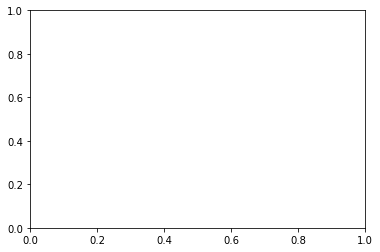

In [ ]:

plt.plot(multiplier_range, assignment_values, label='UTILITY_ASSIGNMENT')
plt.plot(multiplier_range, interest_match_values, label='UTILITY_INTEREST_MATCH')
plt.plot(multiplier_range, good_to_have_match_values, label='UTILITY_MULTIPLIER_SKILL_GOOD_TO_HAVE_MATCH')
plt.plot(multiplier_range, skill_required_match_values, label='UTILITY_MULTIPLIER_SKILL_REQUIRED_MATCH')


plt.xlabel('Multiplier Value')
plt.ylabel('Objective Value')
plt.title('Objective Value vs. Multiplier Value')
plt.legend()
plt.grid(True)

plt.show()

